# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [12]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [13]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [18]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1) ** 2)
    #### END CODE HERE ####
    return penalty

In [19]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [22]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = torch.mean(-crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [23]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [32]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [33]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.10172857748344541, critic loss: 1.9810444167554377


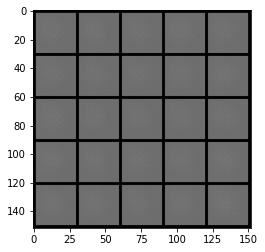

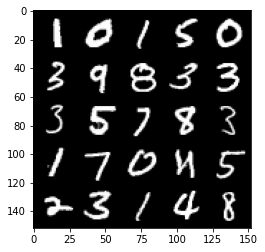

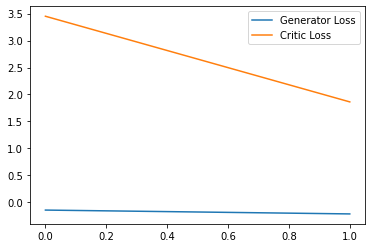

Step 100: Generator loss: 0.9181116735935211, critic loss: -1.7116240640878675


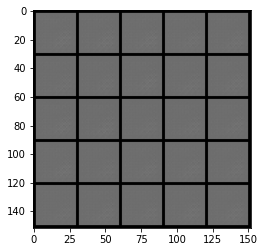

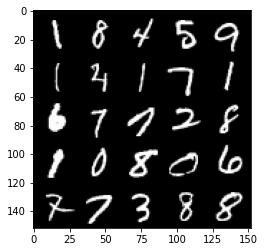

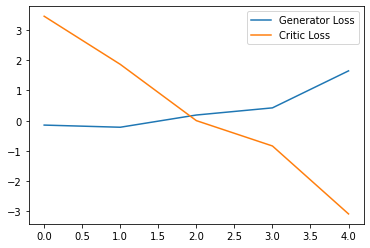

Step 150: Generator loss: 3.62343777179718, critic loss: -11.149864215850828


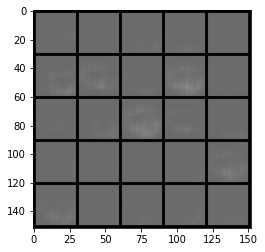

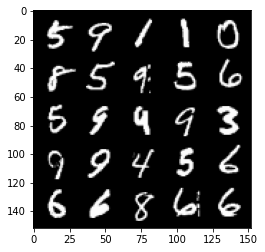

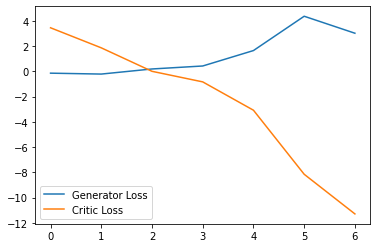

Step 200: Generator loss: 1.4115695618093014, critic loss: -28.456798377990722


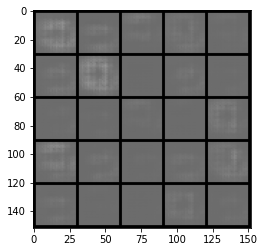

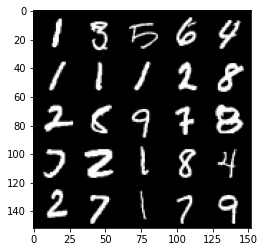

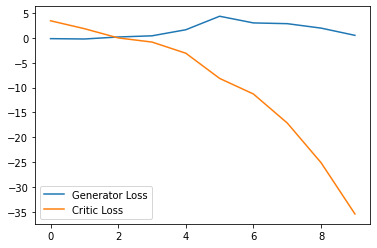

Step 250: Generator loss: -0.5907740285992622, critic loss: -58.52424859619142


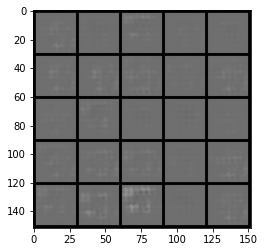

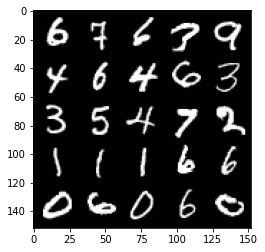

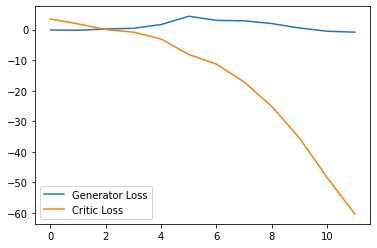

Step 300: Generator loss: 2.0689486913383006, critic loss: -97.17486831665039


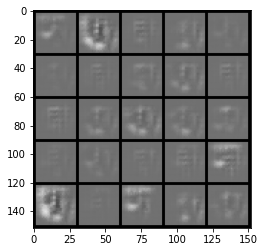

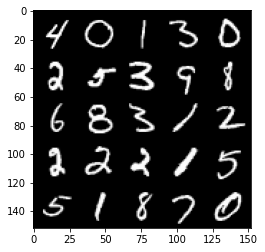

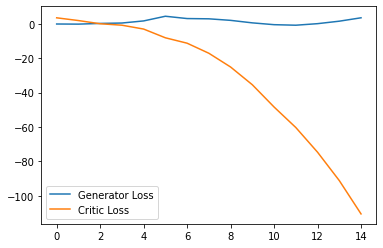

Step 350: Generator loss: 3.0774003398418426, critic loss: -141.70322500610345


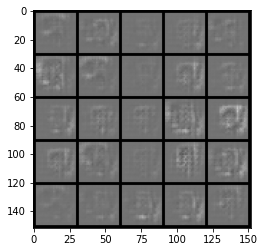

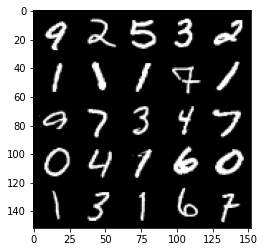

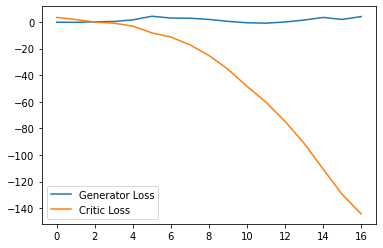

Step 400: Generator loss: 5.8415164422988894, critic loss: -195.6404287109375


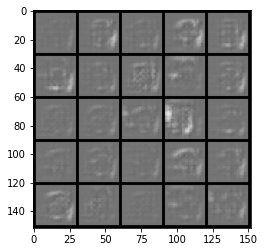

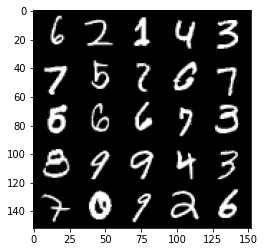

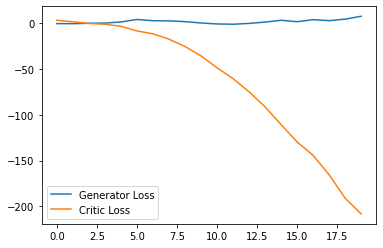

Step 450: Generator loss: 3.3301179575920106, critic loss: -222.6433464202881


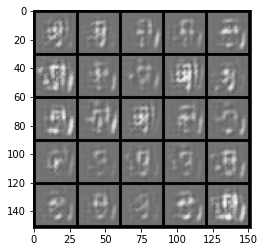

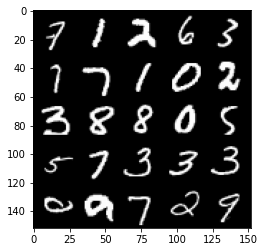

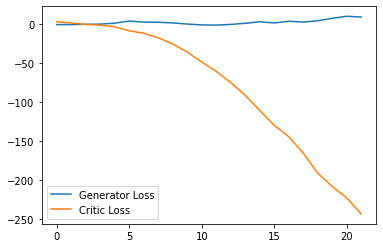

Step 500: Generator loss: 5.037390508651733, critic loss: -241.71761108398445


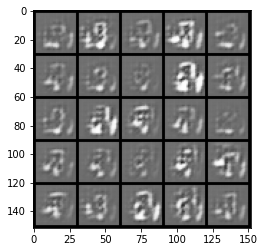

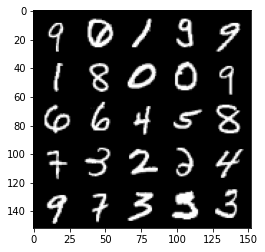

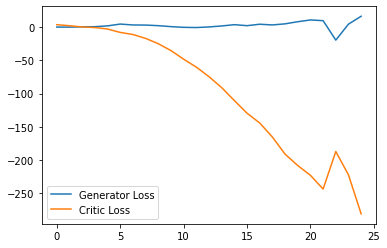

Step 550: Generator loss: 10.014201736450195, critic loss: -325.8708511962891


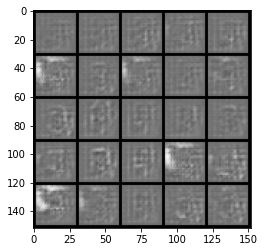

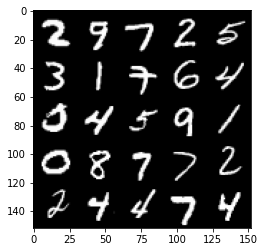

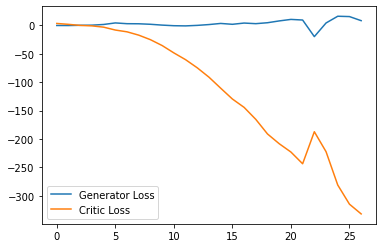

Step 600: Generator loss: -2.65981052339077, critic loss: -361.4783387451171


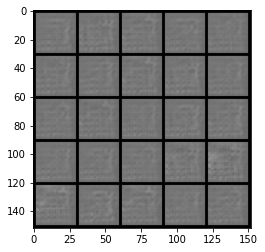

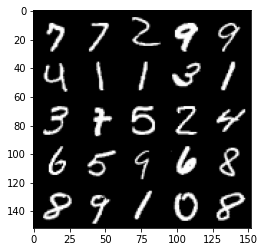

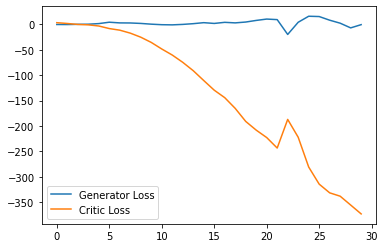

Step 650: Generator loss: 9.411107358932496, critic loss: -417.7117075195311


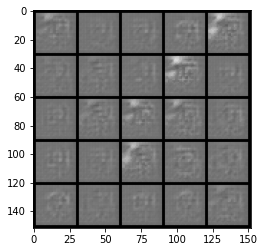

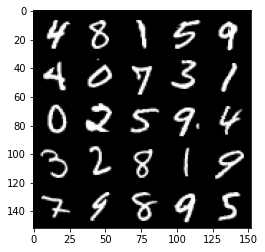

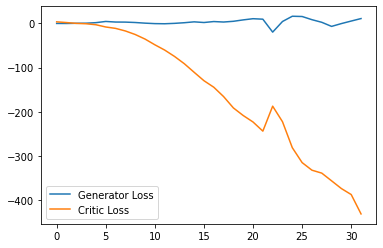

Step 700: Generator loss: 13.368785171508788, critic loss: -477.8215633544921


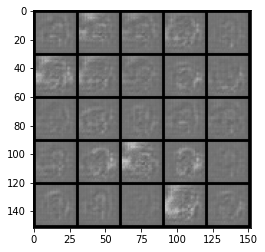

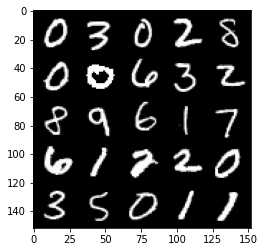

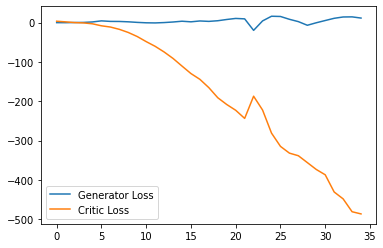

Step 750: Generator loss: 9.8008753657341, critic loss: -519.5604176025391


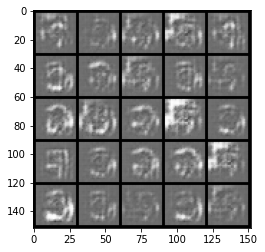

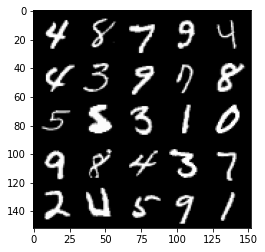

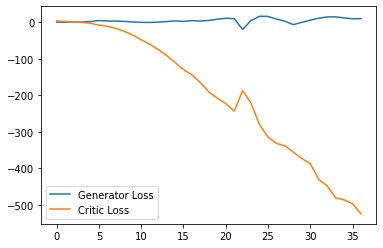

Step 800: Generator loss: -53.81603026390076, critic loss: -391.3017557373047


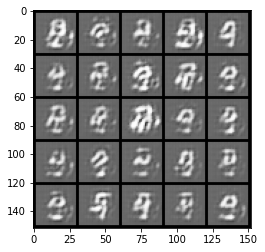

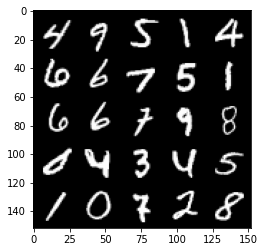

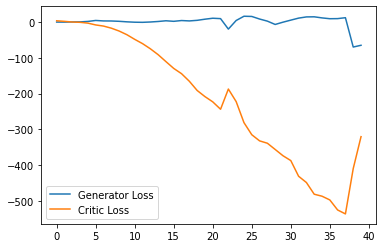

Step 850: Generator loss: -55.613936271667484, critic loss: -289.6864065856933


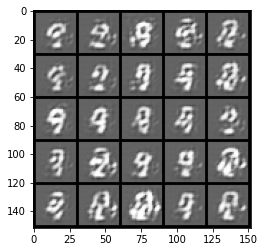

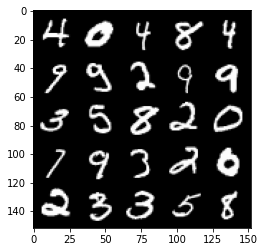

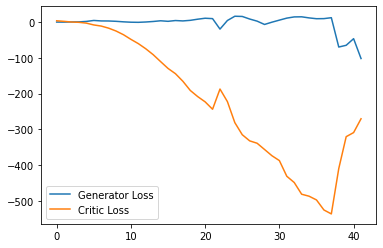

Step 900: Generator loss: -4.793478307723999, critic loss: -322.2139525146485


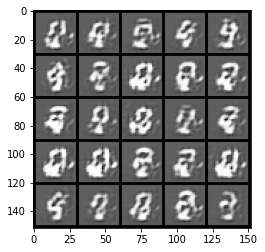

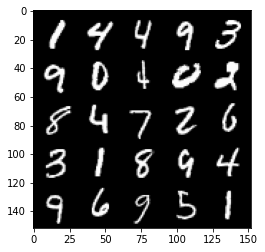

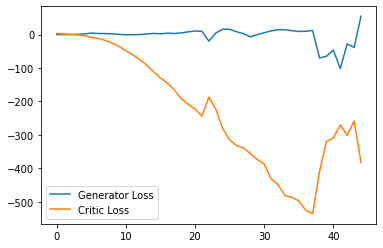

Step 950: Generator loss: 10.45973718881607, critic loss: -404.44904089355475


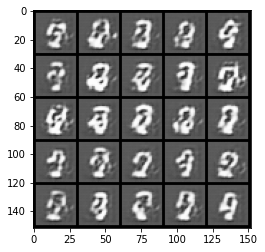

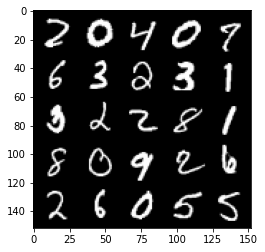

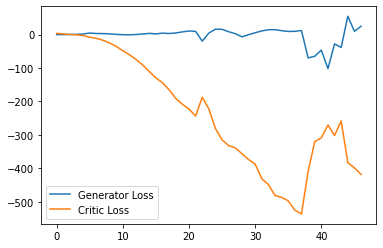

Step 1000: Generator loss: 0.10604061841964722, critic loss: -292.3926115188599


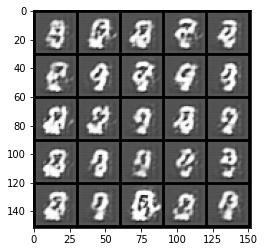

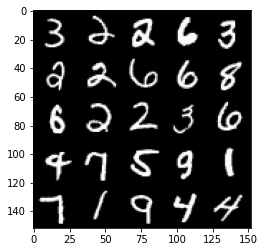

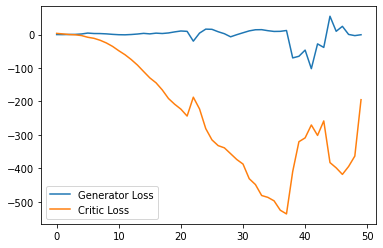

Step 1050: Generator loss: -31.3459534406662, critic loss: -230.8517052307129


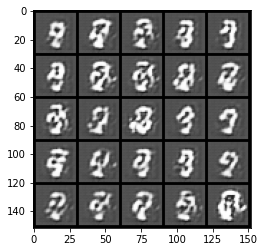

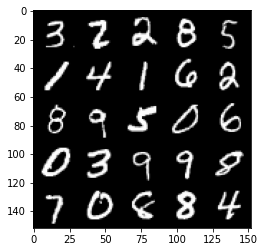

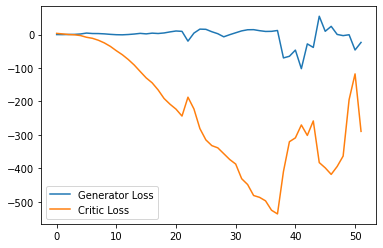

Step 1100: Generator loss: -33.247810320854185, critic loss: -248.6011610412597


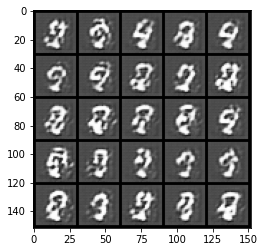

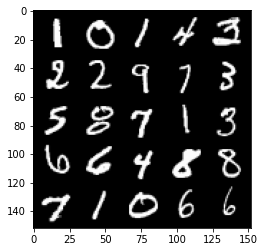

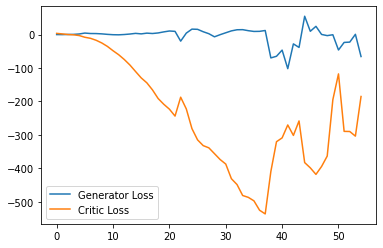

Step 1150: Generator loss: -50.08685557603836, critic loss: -270.16386602783194


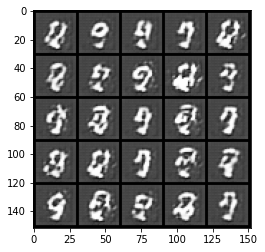

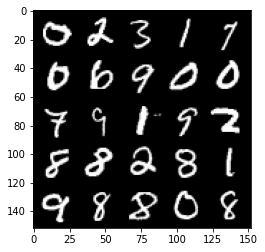

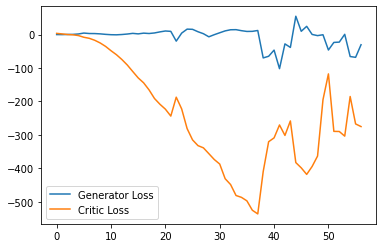

Step 1200: Generator loss: -30.208481278419494, critic loss: -227.12318319702146


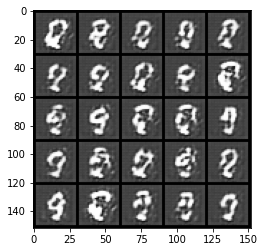

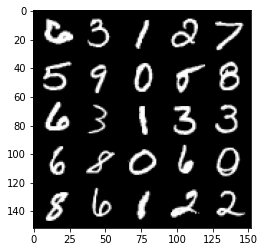

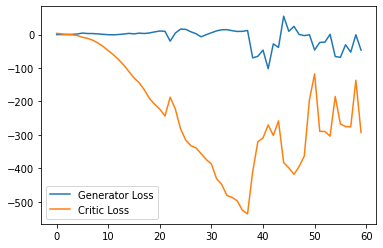

Step 1250: Generator loss: -58.89798042297363, critic loss: -159.0133877105713


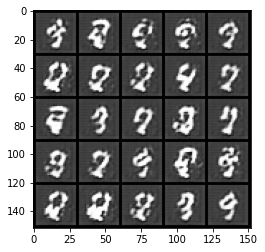

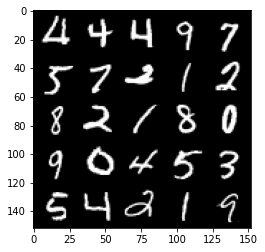

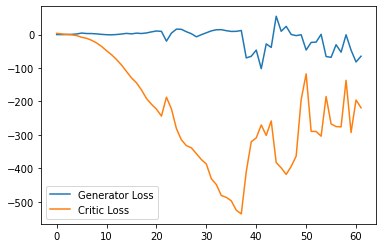

Step 1300: Generator loss: -39.78692939400673, critic loss: -153.23491279602055


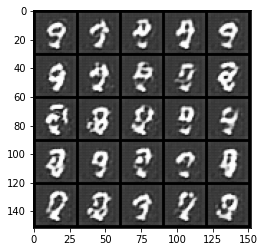

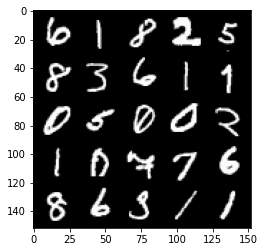

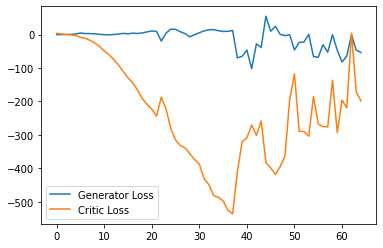

Step 1350: Generator loss: -74.25624290466308, critic loss: -176.65681695556643


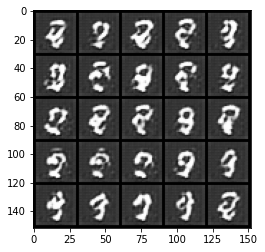

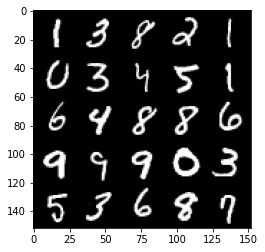

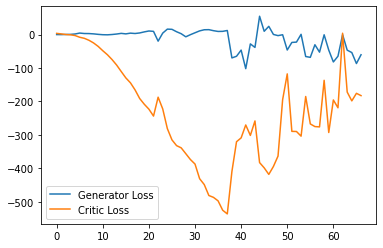

Step 1400: Generator loss: -71.96668704986573, critic loss: -98.58429621887208


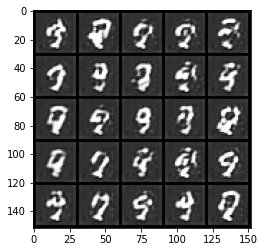

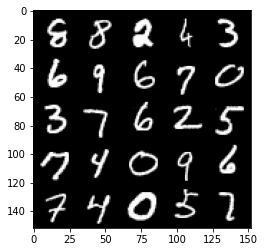

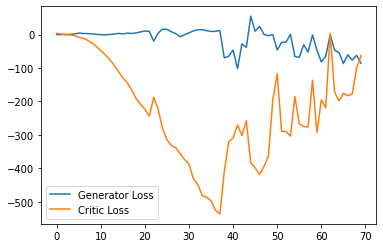

Step 1450: Generator loss: 10.809092807769776, critic loss: 30.705802429199217


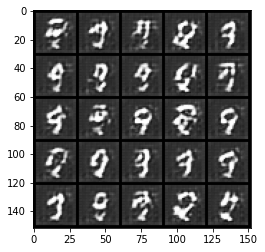

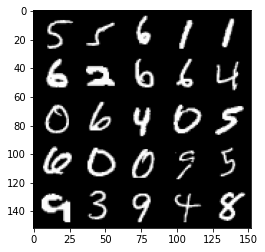

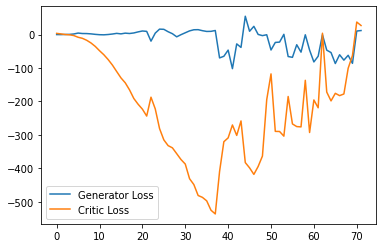

Step 1500: Generator loss: -5.3001868021488185, critic loss: 25.32320639038085


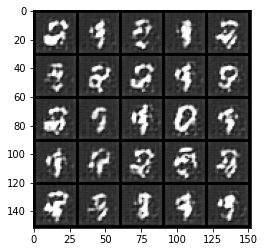

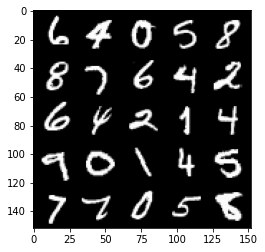

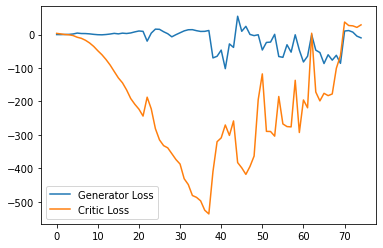

Step 1550: Generator loss: -17.25603626012802, critic loss: 19.843652633666984


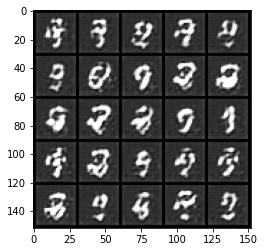

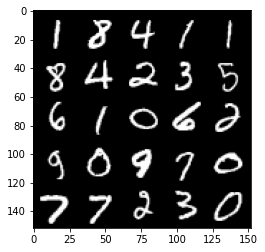

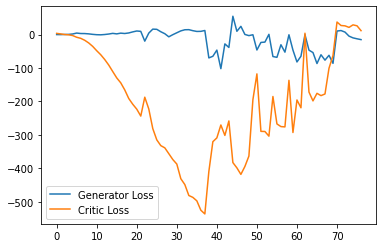

Step 1600: Generator loss: -65.28722333908081, critic loss: -76.34084208679198


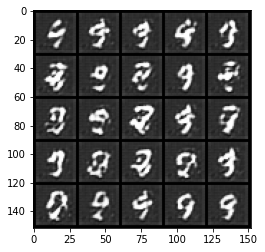

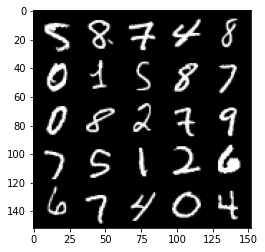

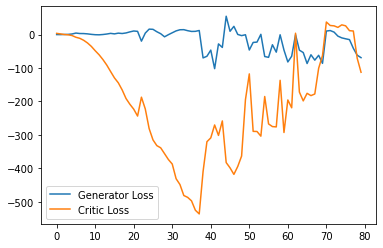

Step 1650: Generator loss: -17.223523914813995, critic loss: -4.274533004760744


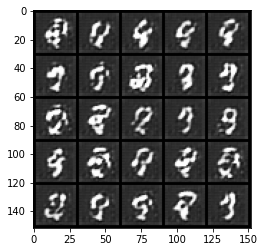

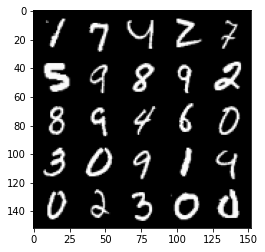

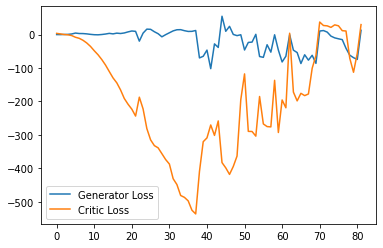

Step 1700: Generator loss: -2.1791406726837157, critic loss: 18.840071815490727


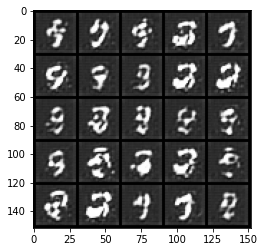

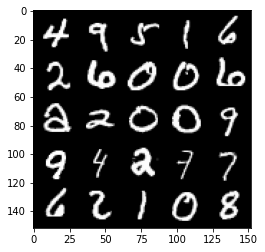

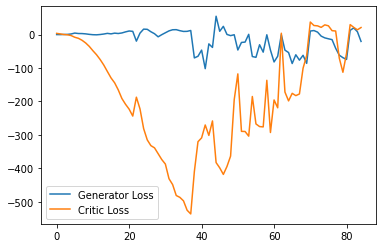

Step 1750: Generator loss: -48.11683300018311, critic loss: -16.444547248840326


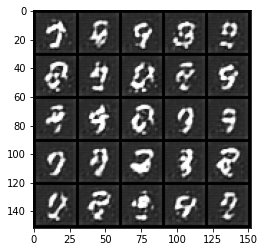

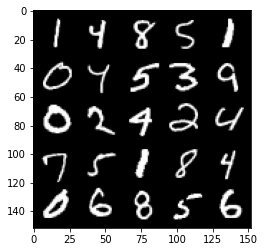

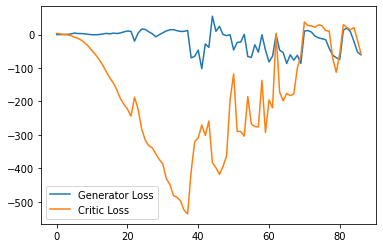

Step 1800: Generator loss: -26.42362493753433, critic loss: -31.99492640686035


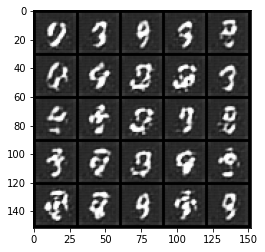

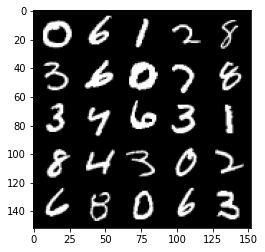

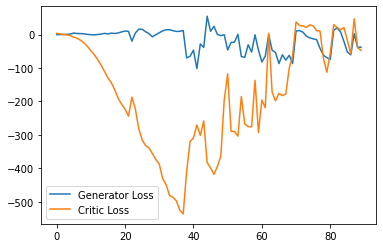

Step 1850: Generator loss: 1.4396796011924744, critic loss: 30.868677787780772


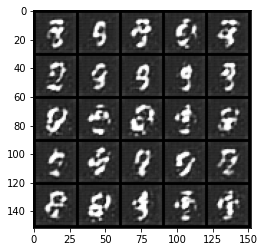

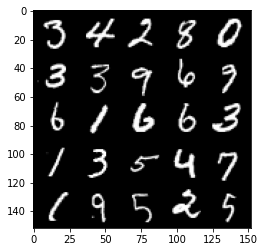

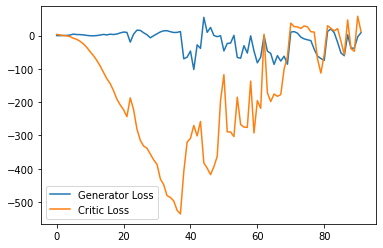

Step 1900: Generator loss: -29.940989634990693, critic loss: -59.84095355224608


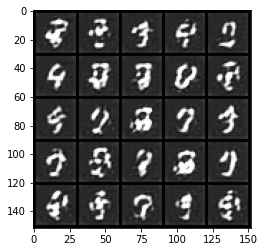

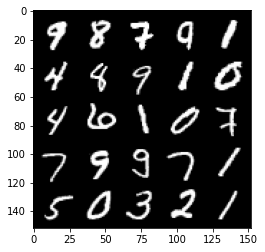

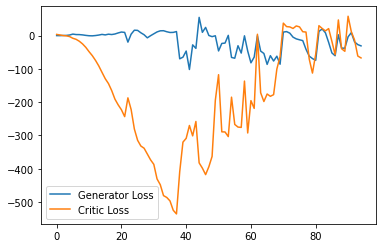

Step 1950: Generator loss: -31.005575082302094, critic loss: -22.20739823913574


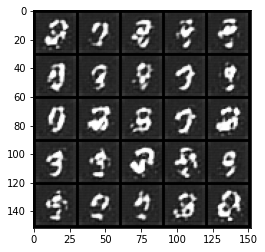

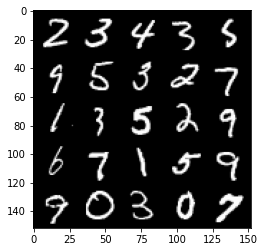

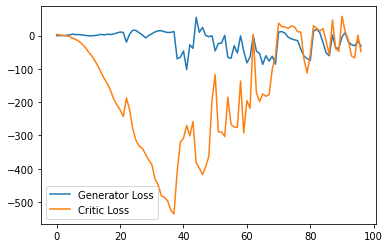

Step 2000: Generator loss: -21.436650717258452, critic loss: -5.570695045471187


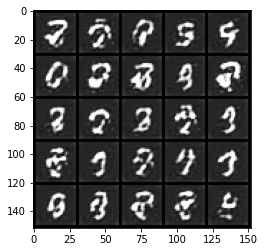

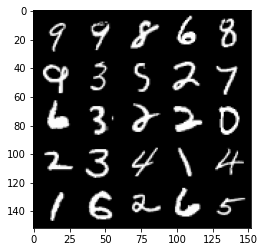

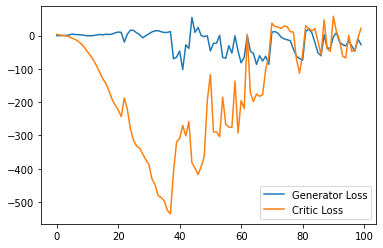

Step 2050: Generator loss: 15.439821529388428, critic loss: 29.428690906524654


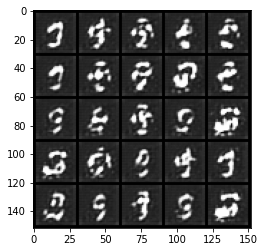

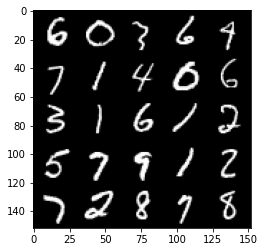

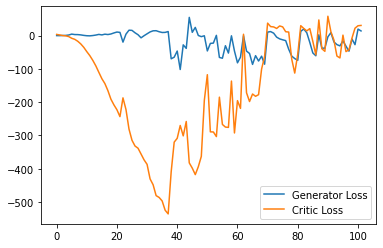

Step 2100: Generator loss: 8.053923635482787, critic loss: 25.49804290390015


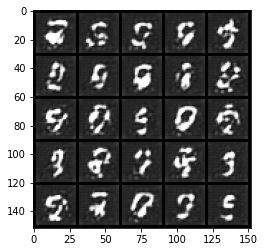

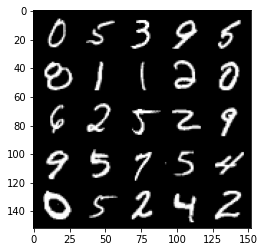

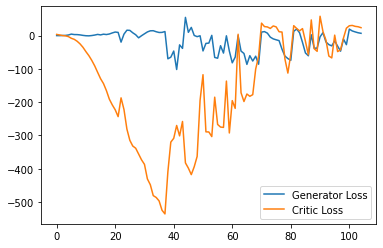

Step 2150: Generator loss: 4.172192072868347, critic loss: 20.771559551239008


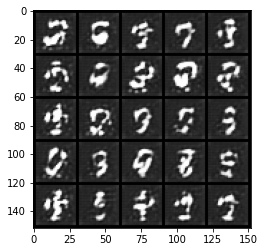

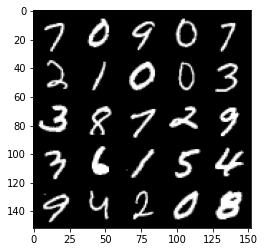

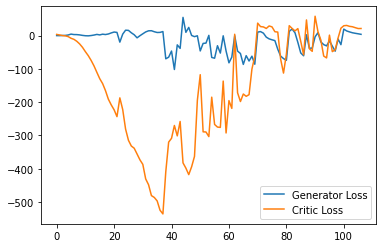

Step 2200: Generator loss: 1.5003867077827453, critic loss: 17.88090929222107


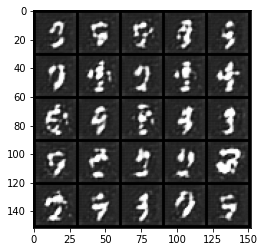

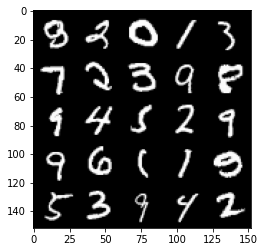

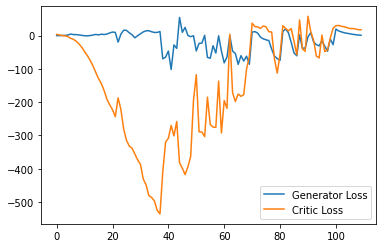

Step 2250: Generator loss: 1.0543563574552537, critic loss: 14.700857049942021


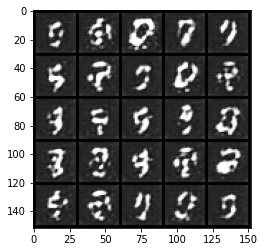

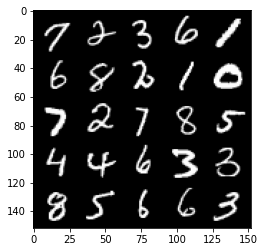

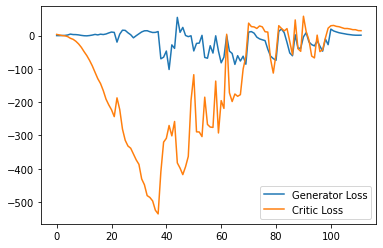

Step 2300: Generator loss: 0.8374963842332364, critic loss: 12.941048770904548


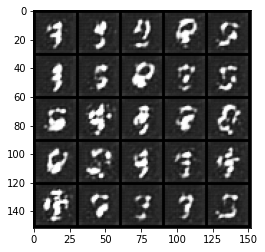

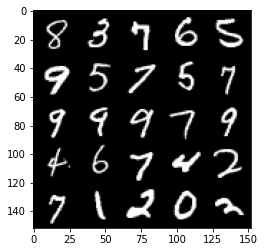

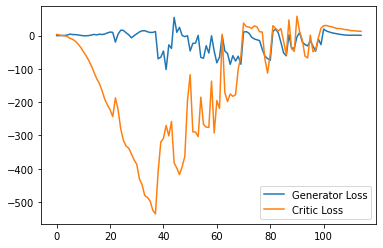

Step 2350: Generator loss: -0.9730419315397739, critic loss: 12.60724426651001


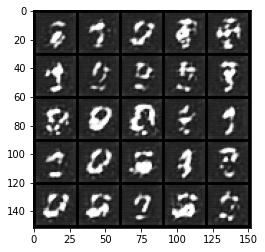

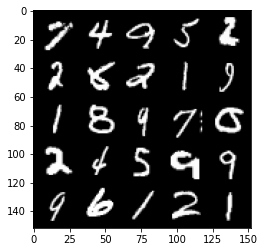

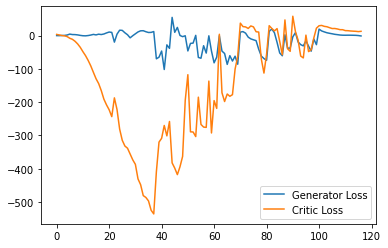

Step 2400: Generator loss: -4.866052160263061, critic loss: 13.459741353988647


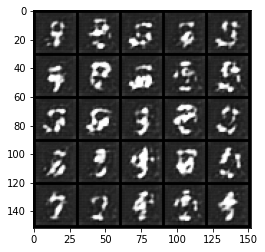

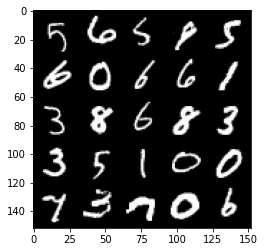

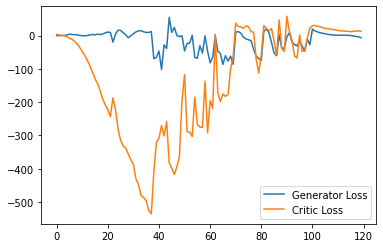

Step 2450: Generator loss: -9.857869997024537, critic loss: 10.934635368347164


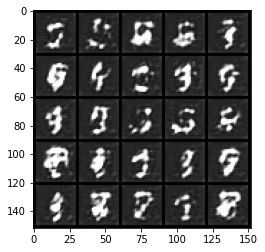

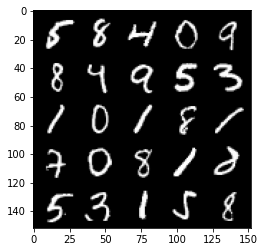

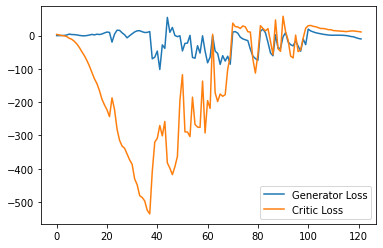

Step 2500: Generator loss: -14.42771360397339, critic loss: 10.850705757141117


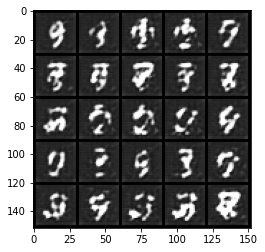

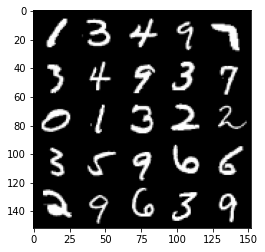

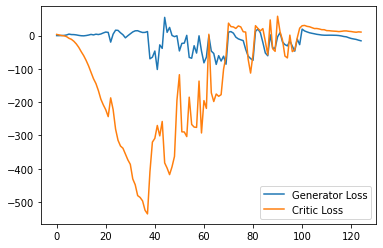

Step 2550: Generator loss: -17.225084533691405, critic loss: 11.633354877471923


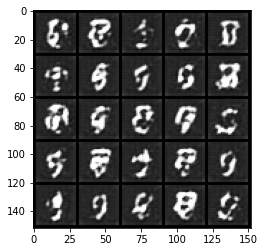

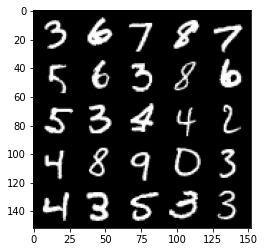

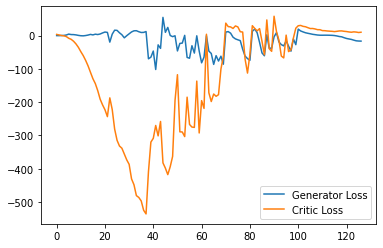

Step 2600: Generator loss: -17.08842212677002, critic loss: 10.357019790649412


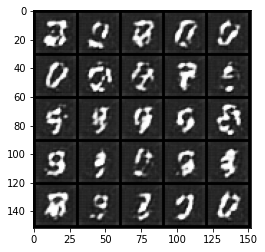

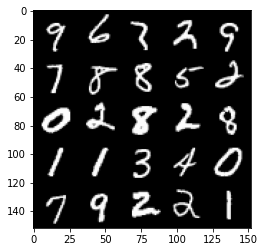

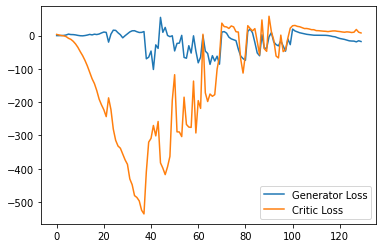

Step 2650: Generator loss: -16.945954084396362, critic loss: 3.8903417358398458


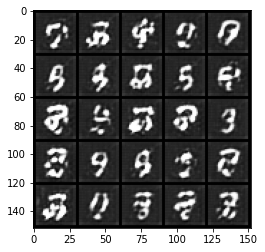

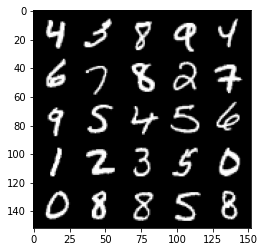

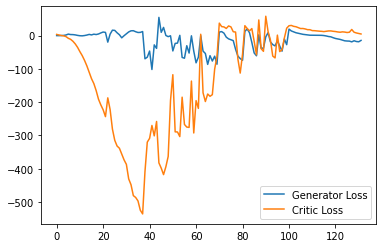

Step 2700: Generator loss: -14.173527088165283, critic loss: 3.8203563613891607


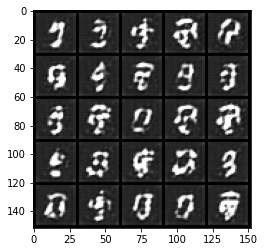

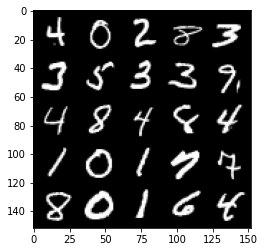

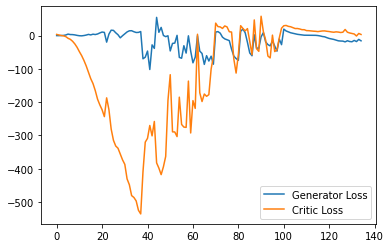

Step 2750: Generator loss: -11.445569218397141, critic loss: -1.3878603172302246


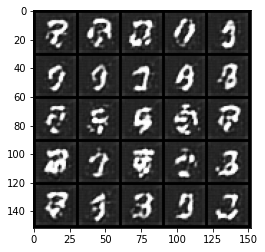

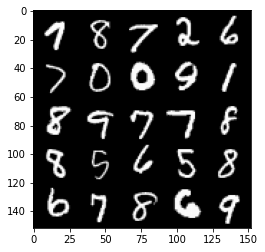

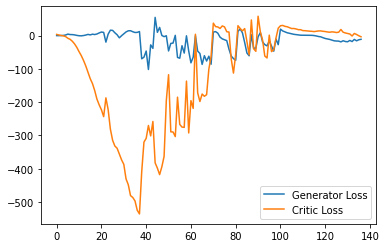

Step 2800: Generator loss: -9.848054786920548, critic loss: -3.7353129844665522


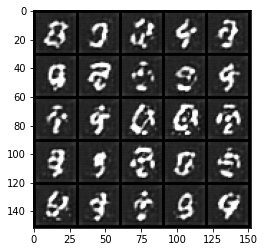

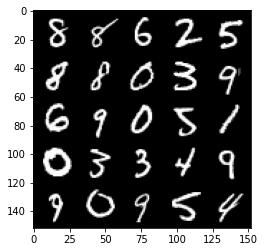

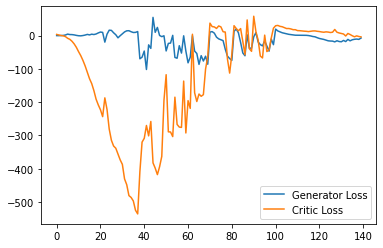

Step 2850: Generator loss: -1.9586144898831845, critic loss: 3.933867330551148


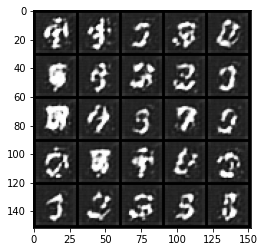

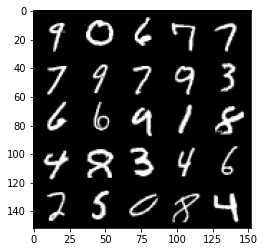

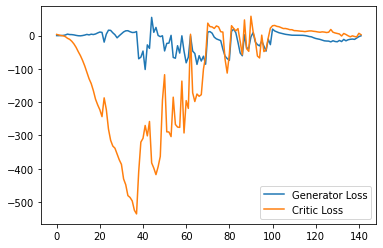

Step 2900: Generator loss: -8.294370808601379, critic loss: -1.9209541893005369


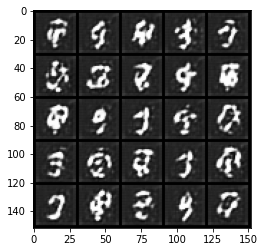

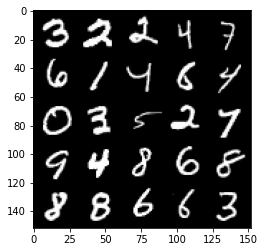

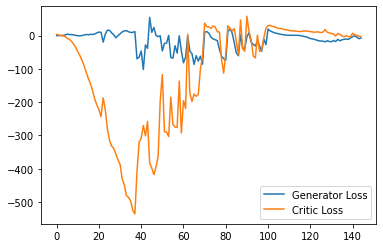

Step 2950: Generator loss: -3.3182898300886152, critic loss: -7.953552352905273


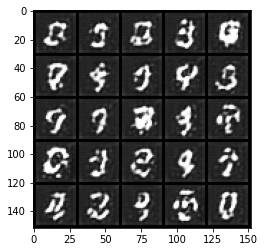

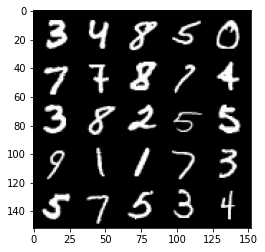

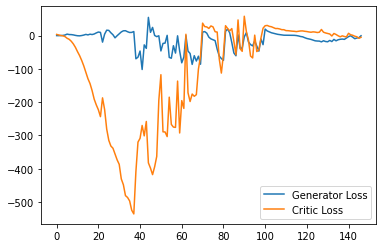

Step 3000: Generator loss: 0.34198902413249016, critic loss: -13.10389299011231


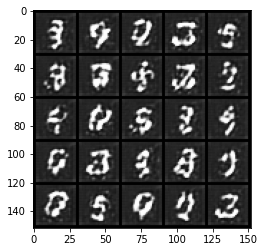

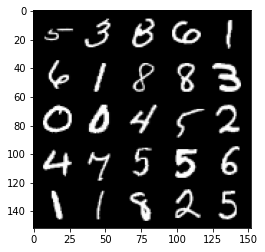

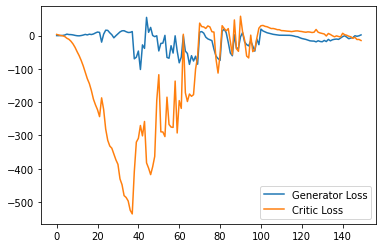

Step 3050: Generator loss: 1.6365472911298276, critic loss: -15.047424119949335


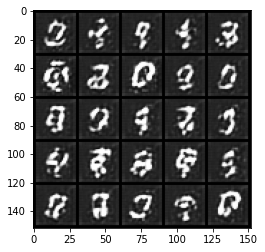

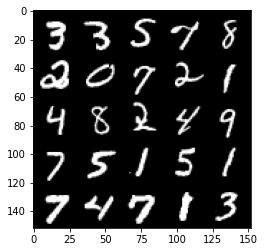

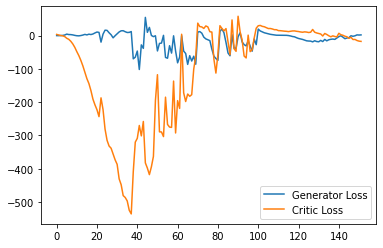

Step 3100: Generator loss: 4.539169438630342, critic loss: -19.29253503417969


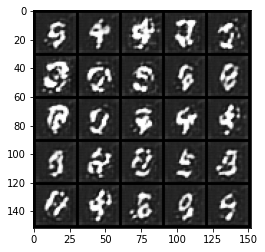

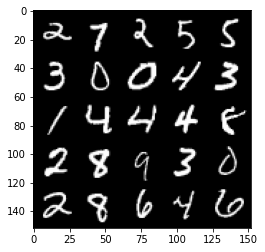

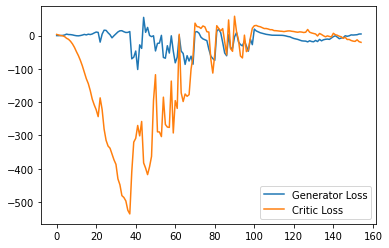

Step 3150: Generator loss: 4.8918497660756115, critic loss: -21.686493026733398


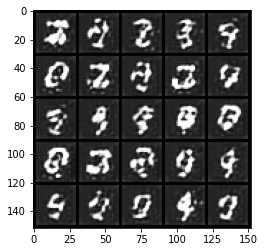

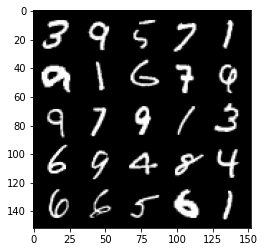

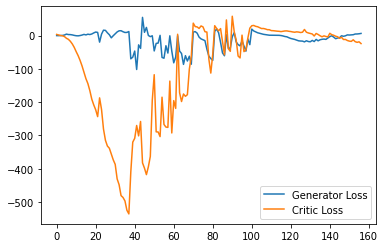

Step 3200: Generator loss: 6.322631042599678, critic loss: -23.053096063613893


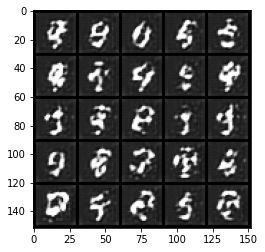

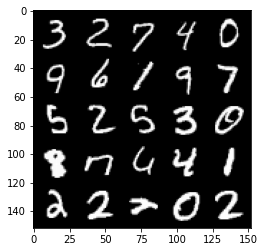

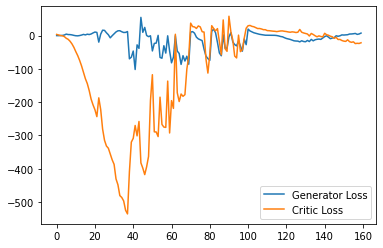

Step 3250: Generator loss: 7.602737739086151, critic loss: -25.76030320358276


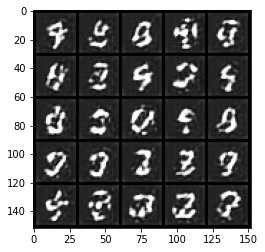

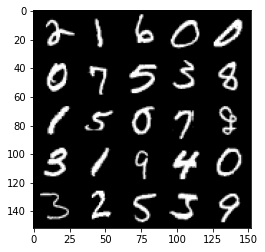

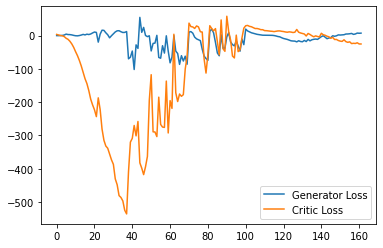

Step 3300: Generator loss: 9.752365188002587, critic loss: -20.215556255340577


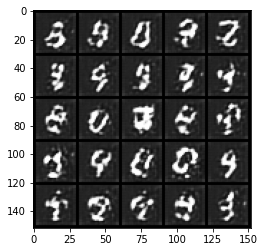

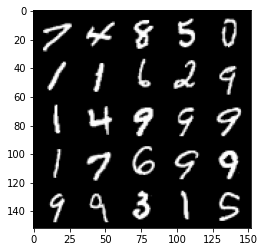

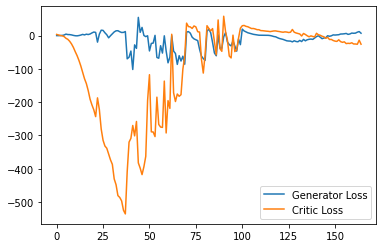

Step 3350: Generator loss: 7.276053267121315, critic loss: -23.1437878112793


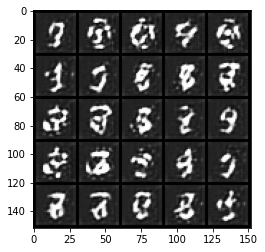

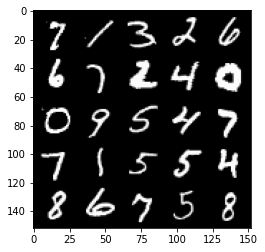

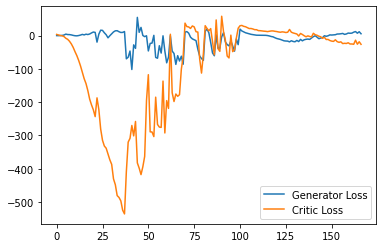

Step 3400: Generator loss: 9.865979566574097, critic loss: -23.84758014106751


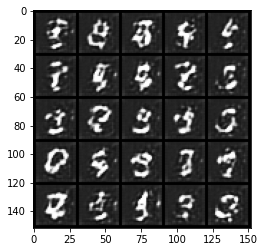

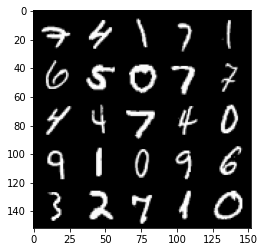

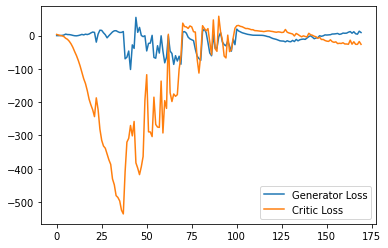

Step 3450: Generator loss: 6.347924997806549, critic loss: -30.568591352462768


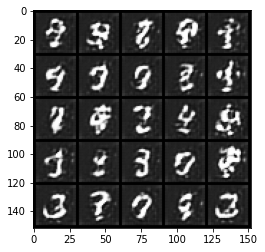

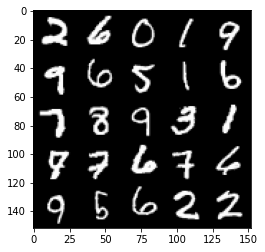

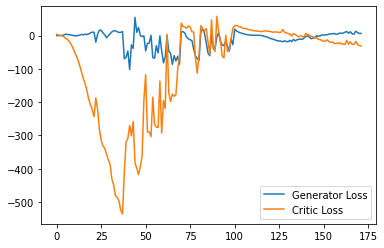

Step 3500: Generator loss: 8.961547042131423, critic loss: -29.54039605522156


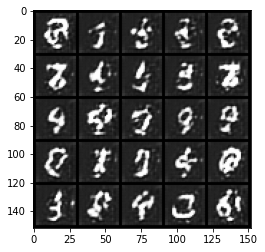

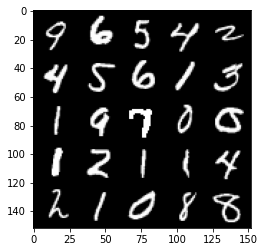

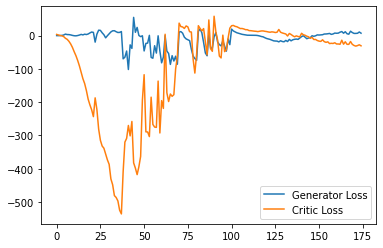

Step 3550: Generator loss: 12.916519660949707, critic loss: -3.3927936573028576


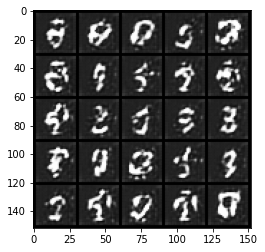

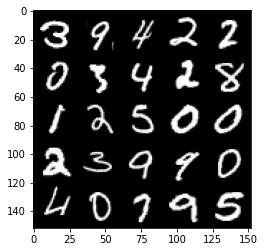

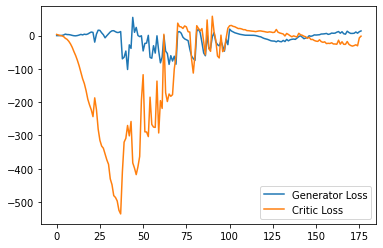

Step 3600: Generator loss: 9.185629123449326, critic loss: -10.981769284248353


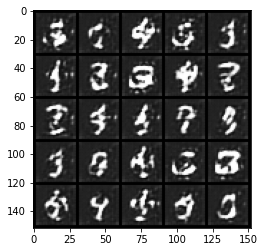

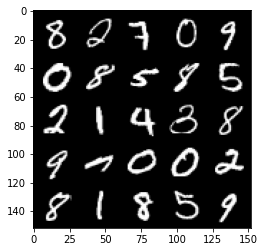

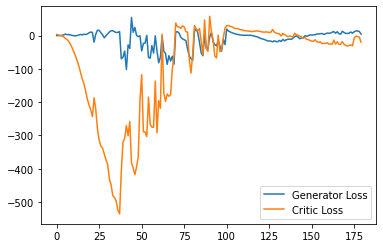

Step 3650: Generator loss: 7.3445357072353366, critic loss: -29.47207405090332


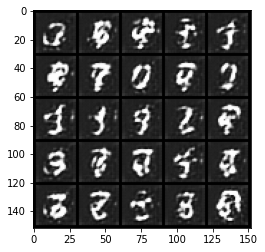

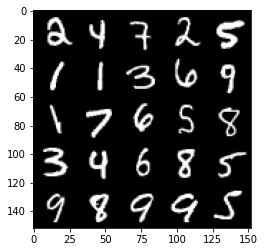

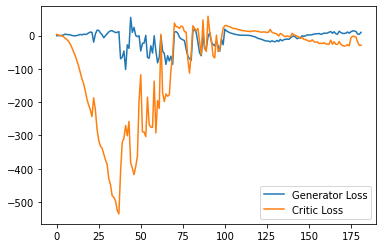

Step 3700: Generator loss: 13.029607570171356, critic loss: -27.23009808826446


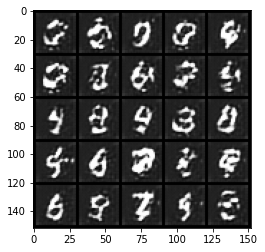

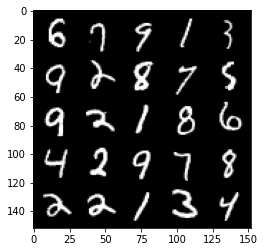

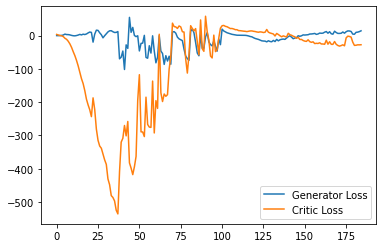

Step 3750: Generator loss: 12.408015106916428, critic loss: -30.29748347854614


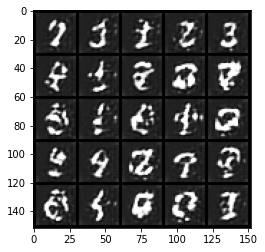

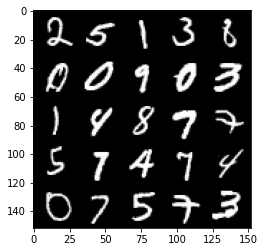

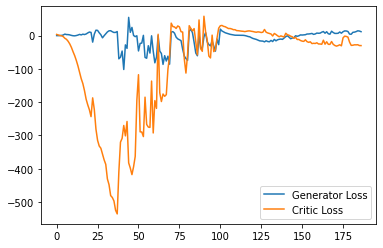

Step 3800: Generator loss: 16.210666535496713, critic loss: -19.733223479270936


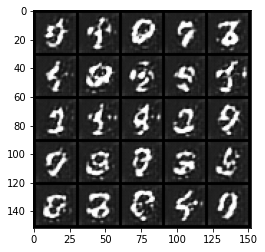

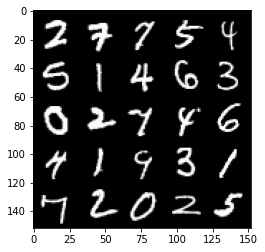

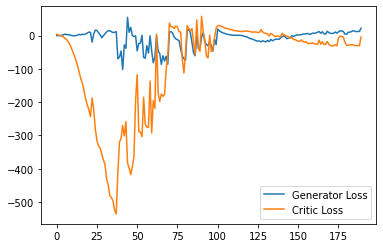

Step 3850: Generator loss: 13.938170623779296, critic loss: -32.31458076095582


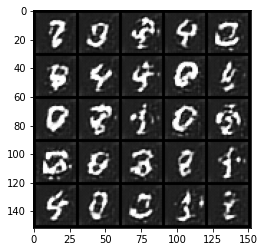

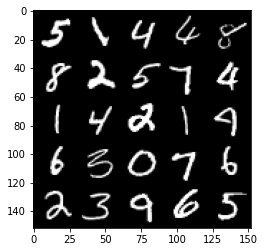

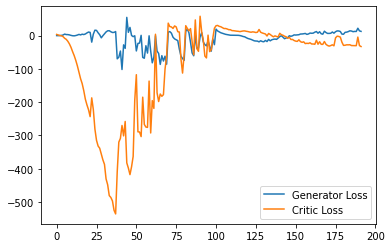

Step 3900: Generator loss: 16.368382754325868, critic loss: -28.431401536941536


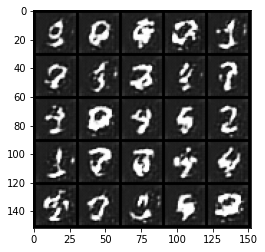

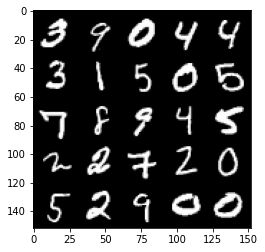

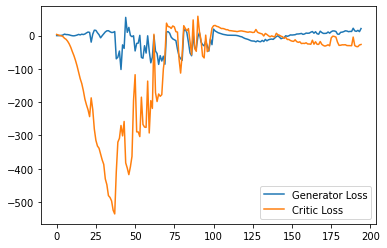

Step 3950: Generator loss: 17.246609611511232, critic loss: -30.430771987915037


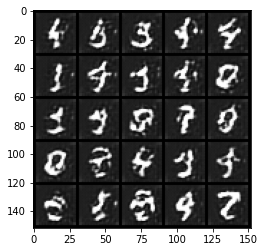

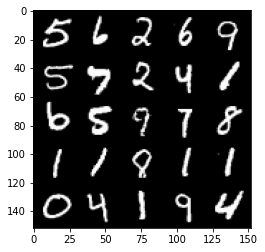

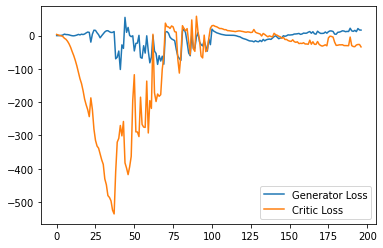

Step 4000: Generator loss: 17.313071069717406, critic loss: -33.46130177879333


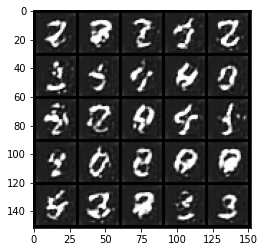

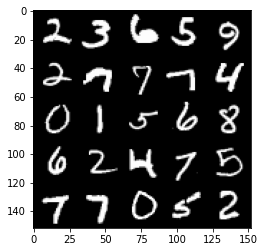

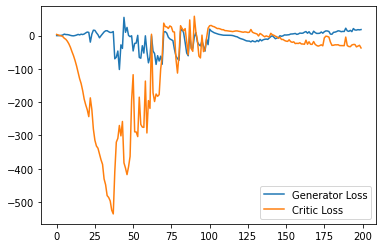

Step 4050: Generator loss: 18.2194788646698, critic loss: -25.682119392395013


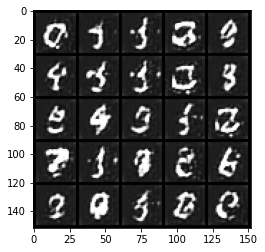

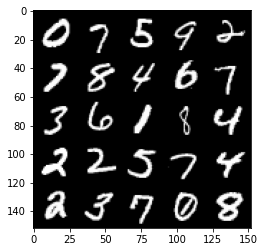

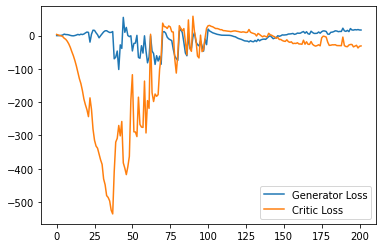

Step 4100: Generator loss: 18.304232625961305, critic loss: -28.967606355667115


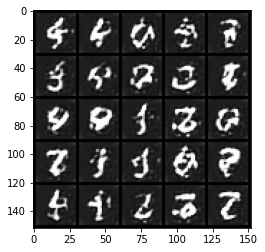

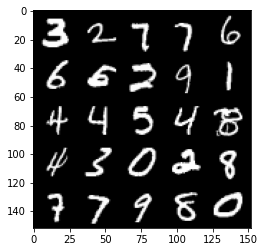

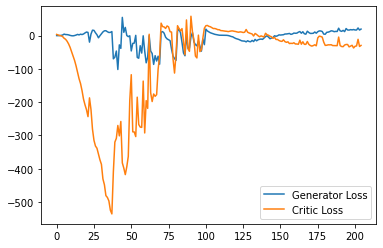

Step 4150: Generator loss: 18.979101428985597, critic loss: -30.73480573081969


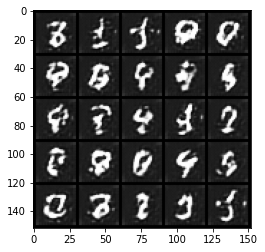

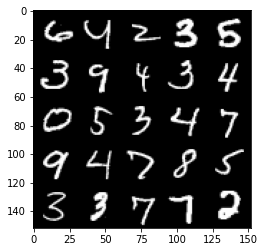

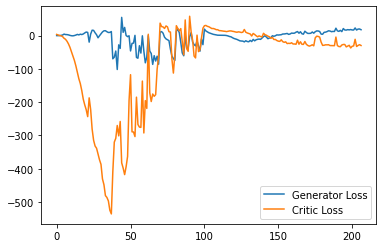

Step 4200: Generator loss: 20.153490161895753, critic loss: -28.125062067031863


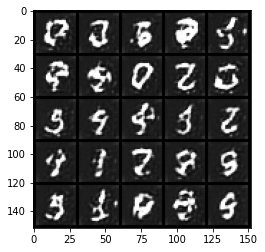

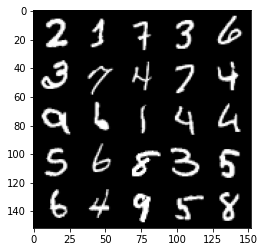

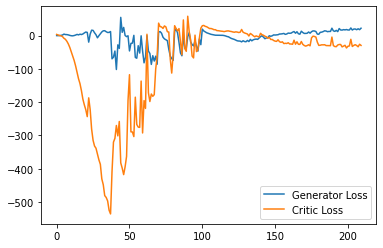

Step 4250: Generator loss: 19.01615889072418, critic loss: -31.489838172912595


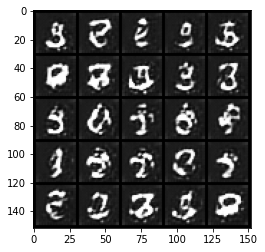

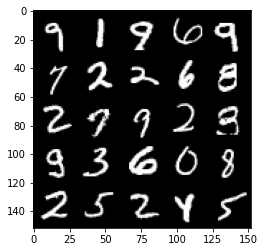

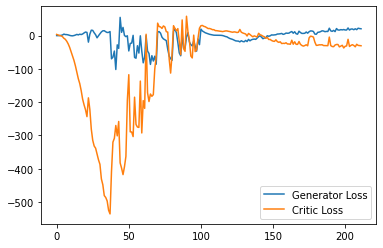

Step 4300: Generator loss: 21.09909618139267, critic loss: -25.539846824646002


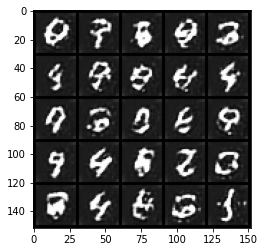

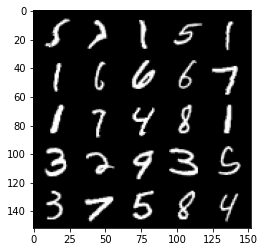

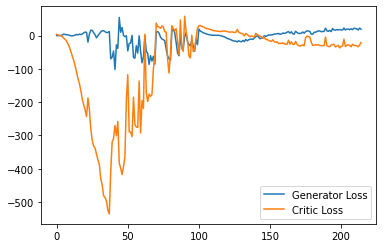

Step 4350: Generator loss: 18.94417232513428, critic loss: -30.429871575355527


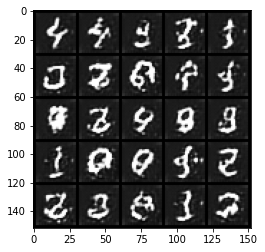

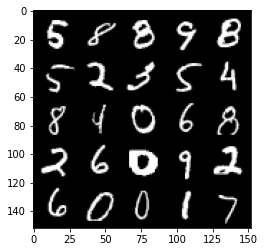

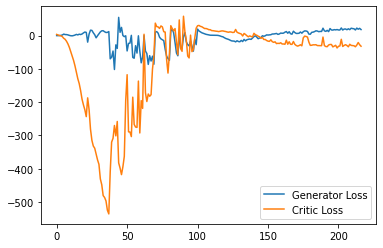

Step 4400: Generator loss: 26.50550847053528, critic loss: -6.736287564754483


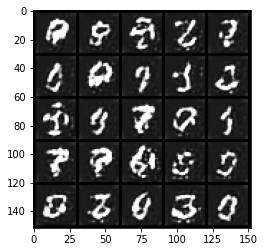

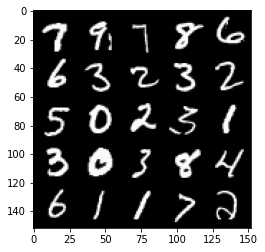

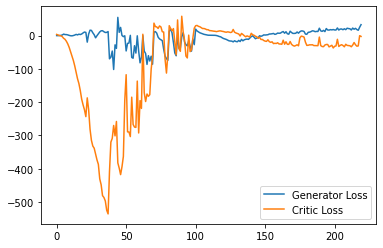

Step 4450: Generator loss: 30.61676128387451, critic loss: -2.255710645198822


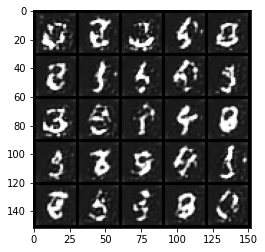

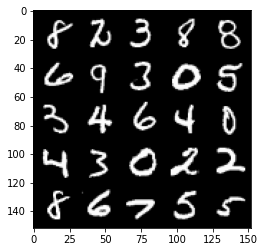

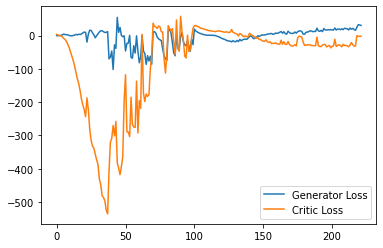

Step 4500: Generator loss: 27.204604148864746, critic loss: -2.7196180300712576


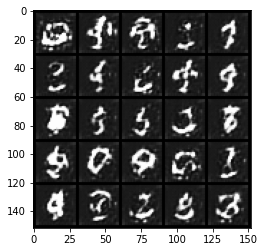

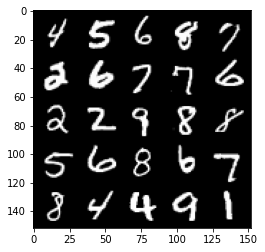

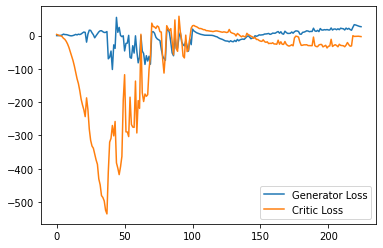

Step 4550: Generator loss: 22.189180221557617, critic loss: -7.50507613658905


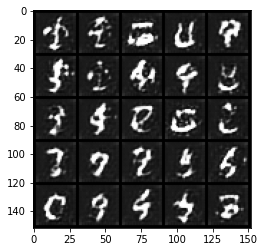

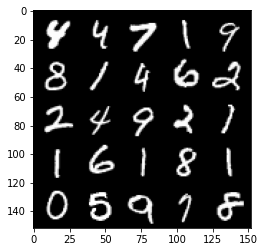

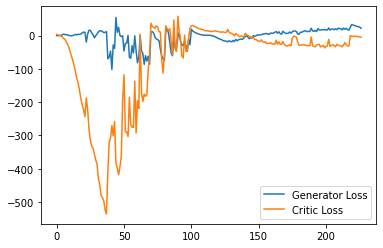

Step 4600: Generator loss: 20.292808499336243, critic loss: -18.761791805267336


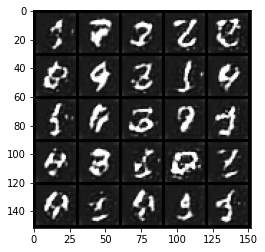

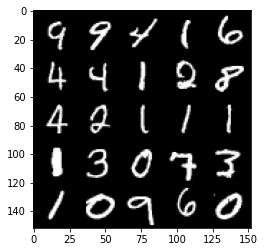

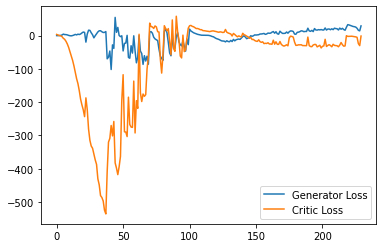

Step 4650: Generator loss: 17.160497266948223, critic loss: -26.350293186187756


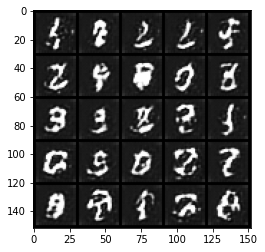

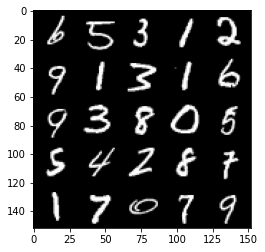

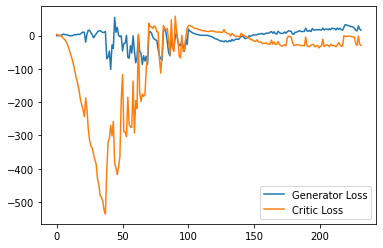

Step 4700: Generator loss: 25.14053970336914, critic loss: -27.396820157051085


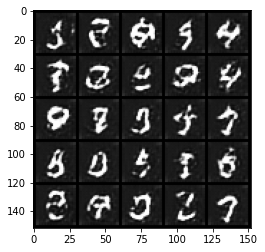

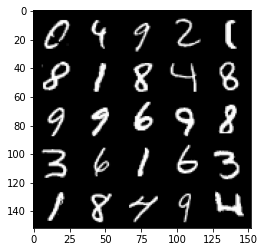

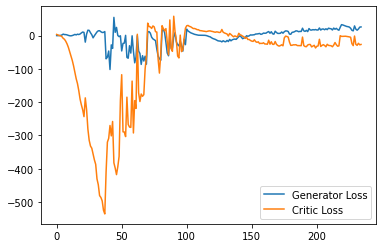

Step 4750: Generator loss: 21.838276424407958, critic loss: -26.102446718215948


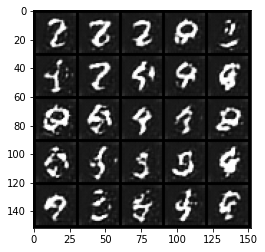

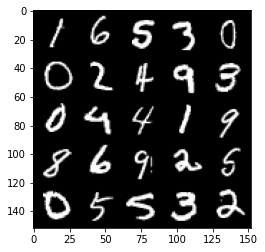

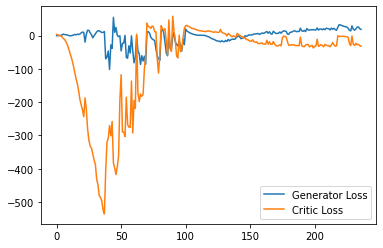

Step 4800: Generator loss: 24.39028787612915, critic loss: -28.61428223514557


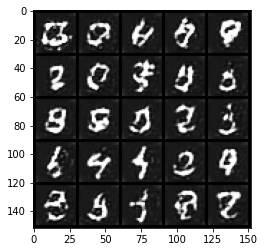

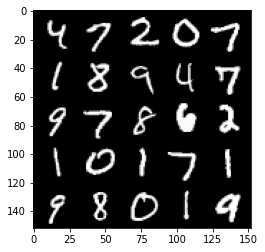

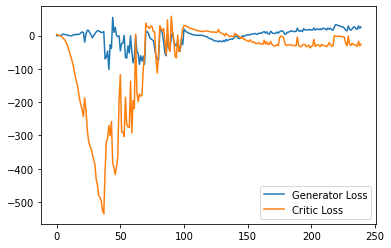

Step 4850: Generator loss: 27.226876525878907, critic loss: -19.450307996749874


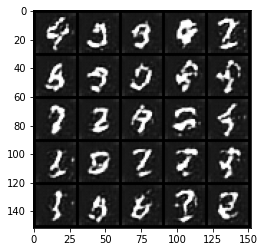

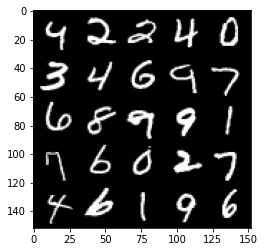

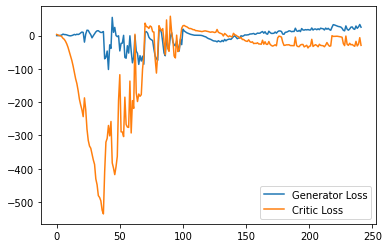

Step 4900: Generator loss: 27.295030384063722, critic loss: -18.623485358238224


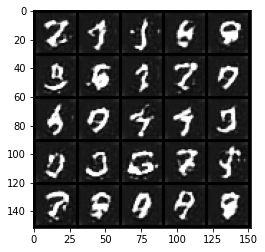

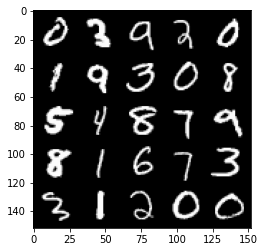

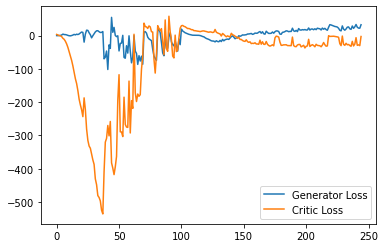

Step 4950: Generator loss: 28.47292091369629, critic loss: -23.953841114997868


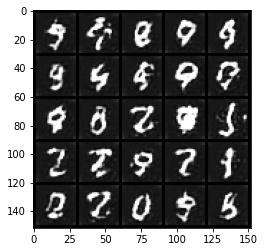

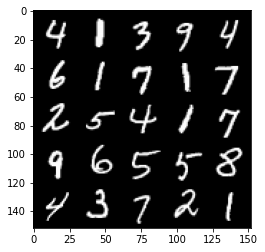

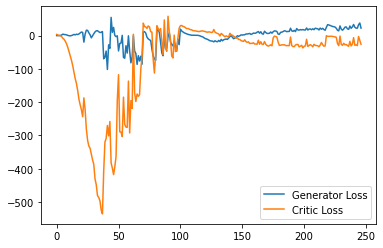

Step 5000: Generator loss: 24.47263452529907, critic loss: -28.70044116020202


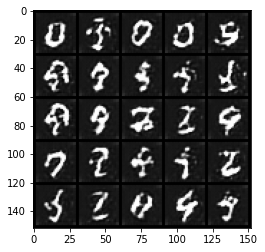

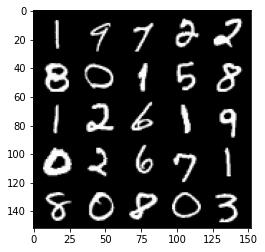

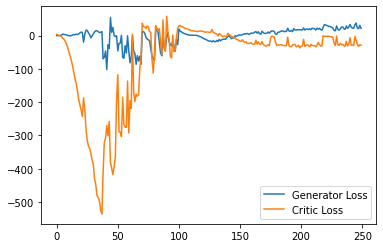

Step 5050: Generator loss: 29.28987319946289, critic loss: -22.44603564834595


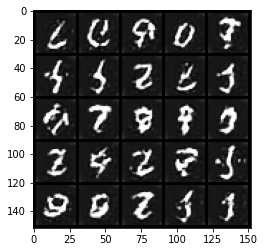

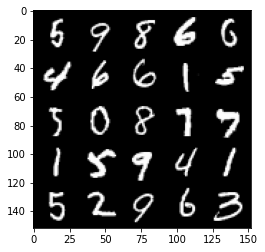

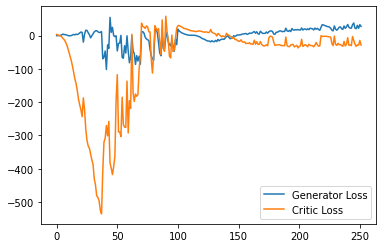

Step 5100: Generator loss: 28.452325019836426, critic loss: -5.232415864944459


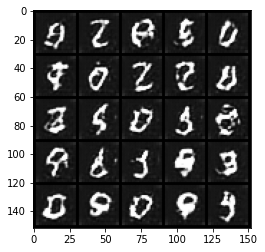

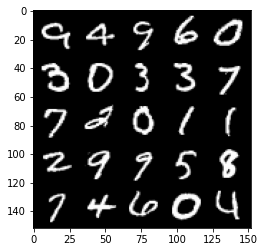

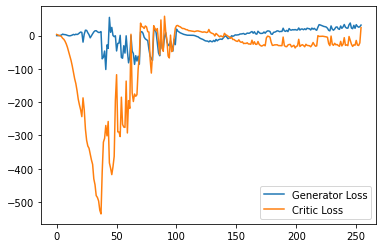

Step 5150: Generator loss: 37.60149810791015, critic loss: -1.634156267642975


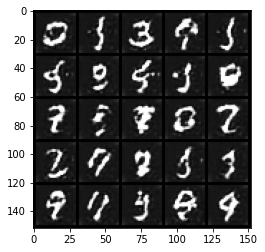

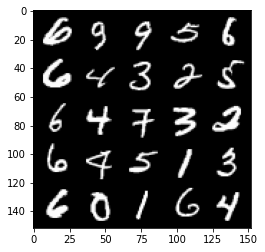

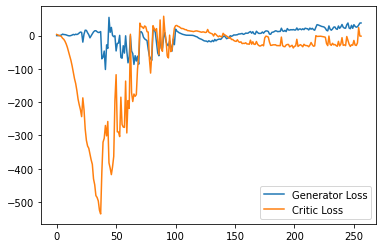

Step 5200: Generator loss: 35.200047149658204, critic loss: -1.4904073104858397


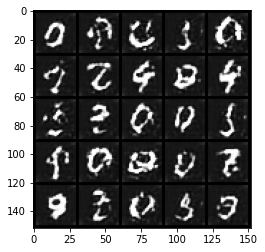

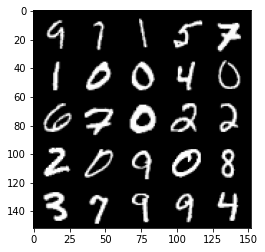

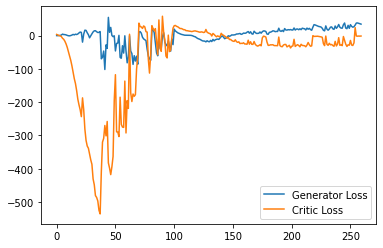

Step 5250: Generator loss: 32.256088714599606, critic loss: -1.8256320428848267


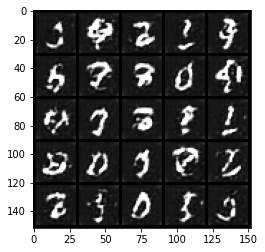

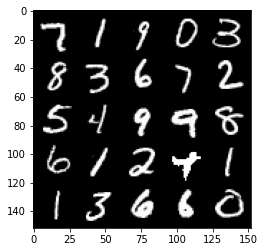

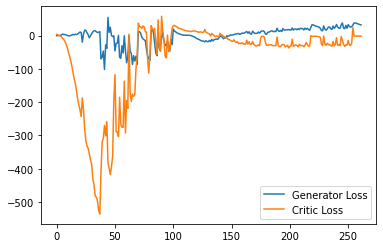

Step 5300: Generator loss: 31.380309181213377, critic loss: -1.9327592840194705


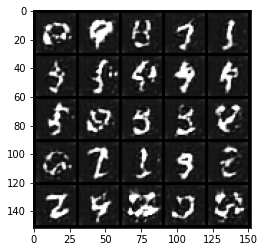

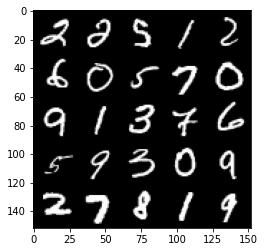

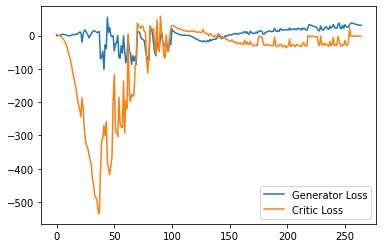

Step 5350: Generator loss: 30.774652862548827, critic loss: -2.562386675834656


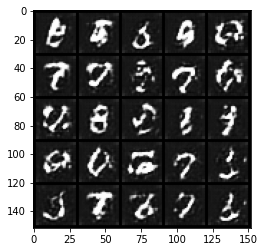

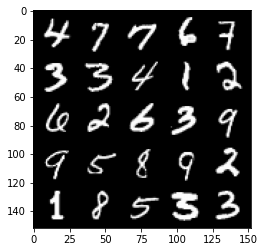

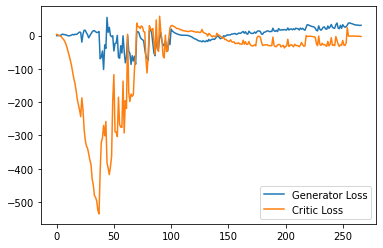

Step 5400: Generator loss: 31.360090065002442, critic loss: -2.904684604644777


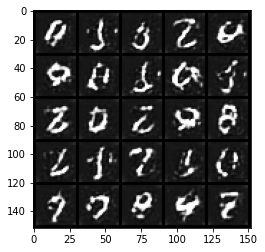

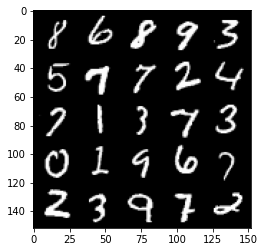

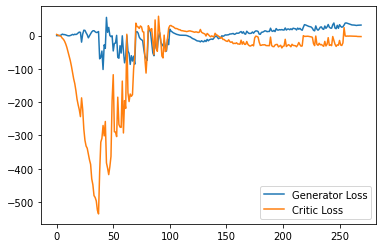

Step 5450: Generator loss: 31.870361251831056, critic loss: -3.9034051389694207


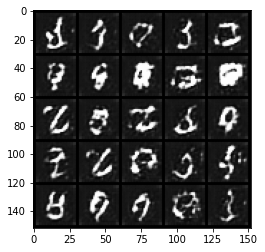

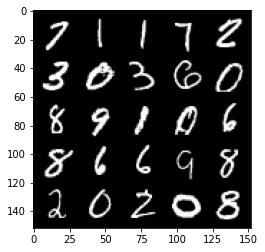

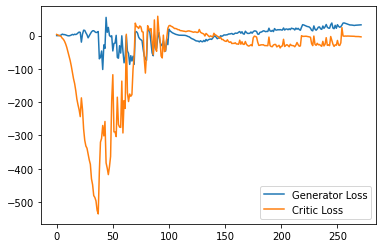

Step 5500: Generator loss: 28.323057441711427, critic loss: -4.907012804031375


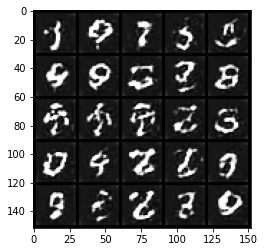

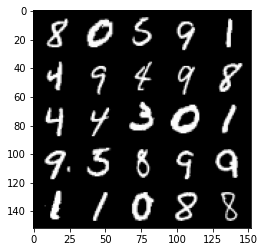

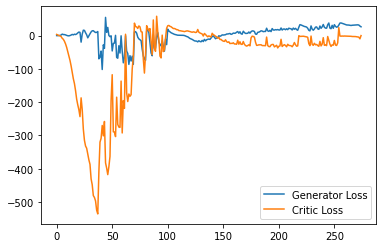

Step 5550: Generator loss: 32.470987510681155, critic loss: -4.448180273056032


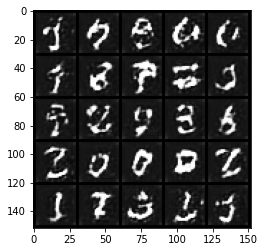

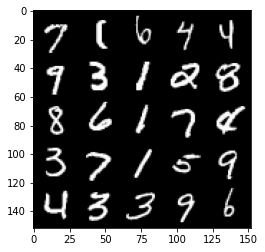

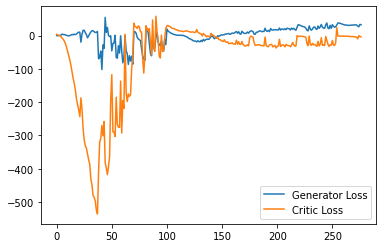

Step 5600: Generator loss: 18.87712664604187, critic loss: -30.46757250595092


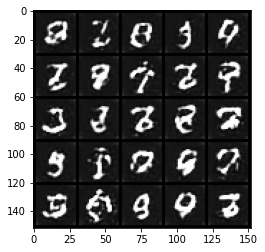

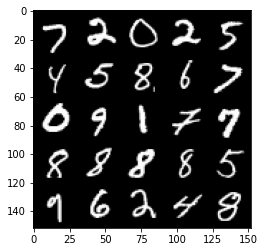

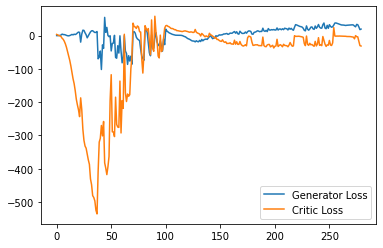

Step 5650: Generator loss: 26.20964168548584, critic loss: -28.41561893653869


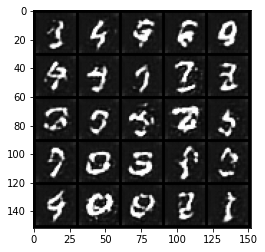

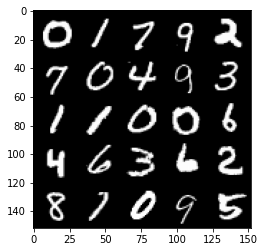

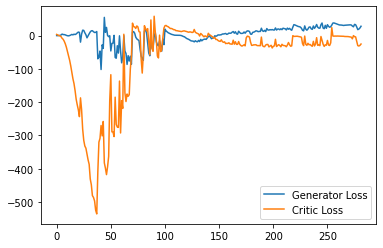

Step 5700: Generator loss: 36.0490961265564, critic loss: 2.7014748339653005


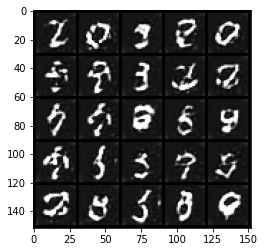

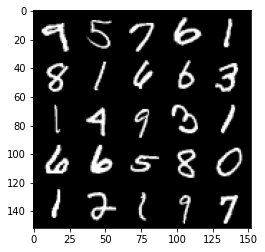

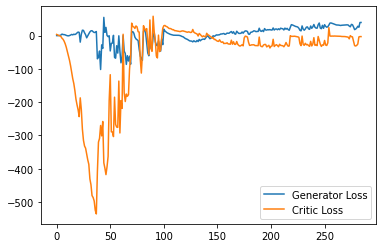

Step 5750: Generator loss: 37.58459678649902, critic loss: -2.9850632019042966


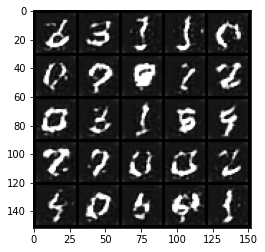

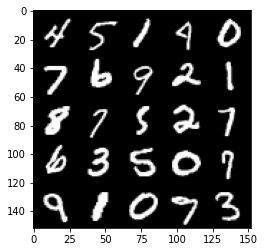

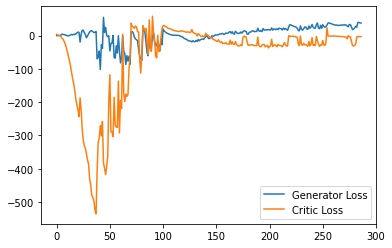

Step 5800: Generator loss: 35.798084564208985, critic loss: -3.0037893047332767


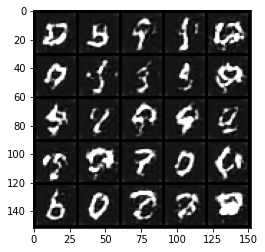

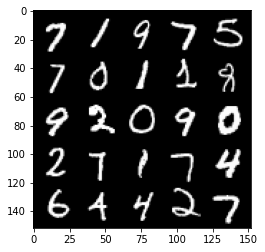

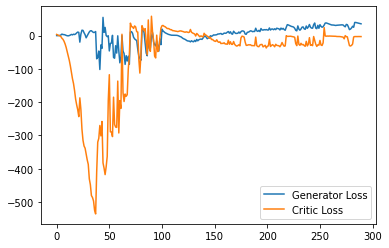

Step 5850: Generator loss: 33.712094421386716, critic loss: -4.038697758674622


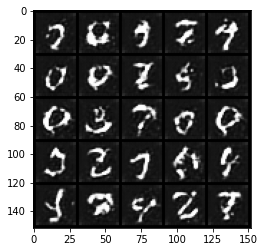

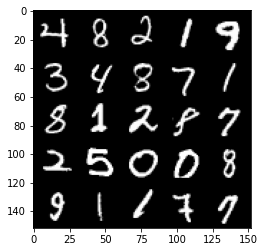

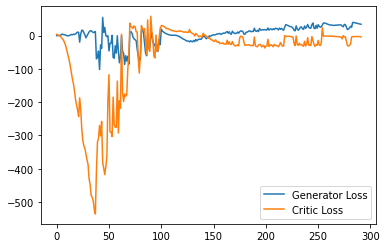

Step 5900: Generator loss: 32.95347256660462, critic loss: -6.3019523162841775


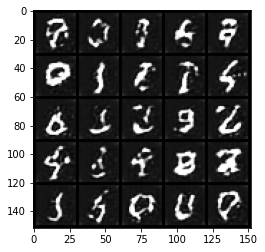

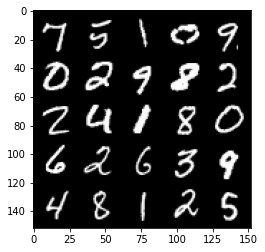

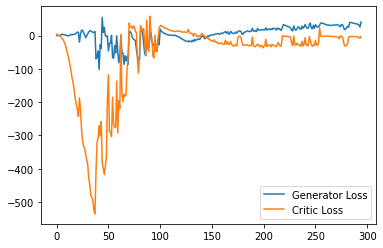

Step 5950: Generator loss: 38.3369075012207, critic loss: -3.368660828590391


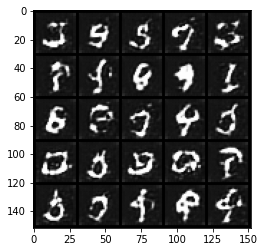

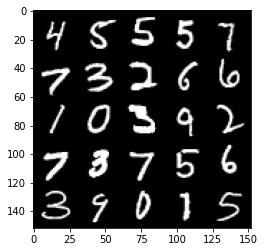

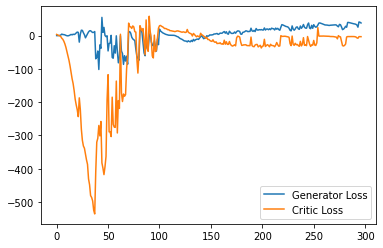

Step 6000: Generator loss: 35.05160499572754, critic loss: -4.807852372169495


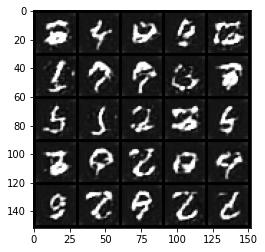

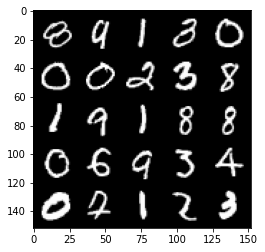

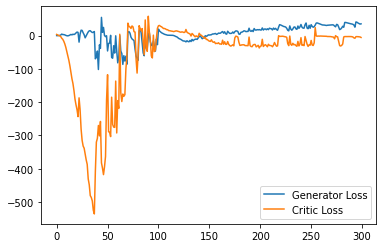

Step 6050: Generator loss: 22.56369514465332, critic loss: -25.51956711387634


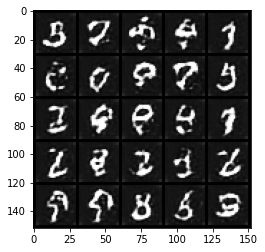

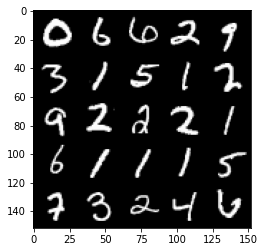

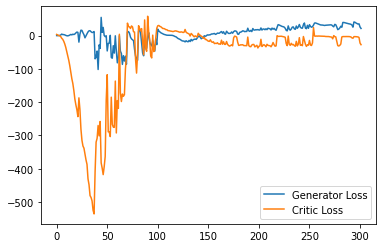

Step 6100: Generator loss: 38.00006568908692, critic loss: -5.32867975616455


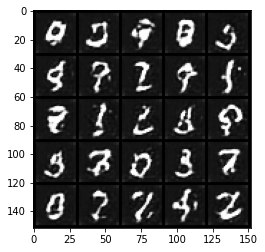

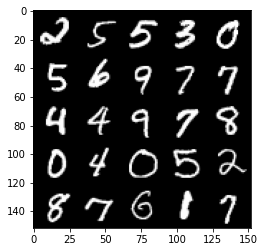

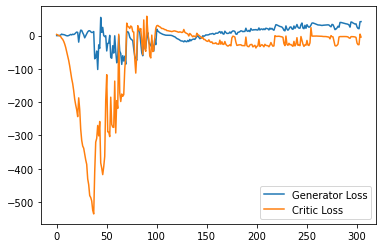

Step 6150: Generator loss: 27.270053062438965, critic loss: -23.504370396614082


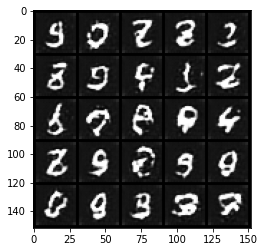

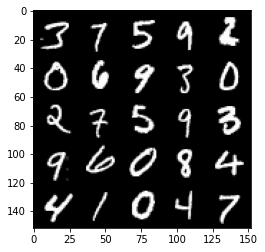

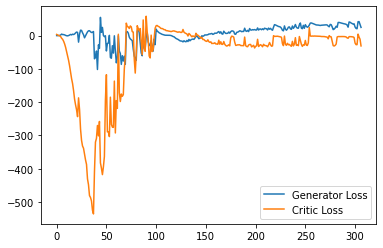

Step 6200: Generator loss: 25.72629041671753, critic loss: -27.422396842956537


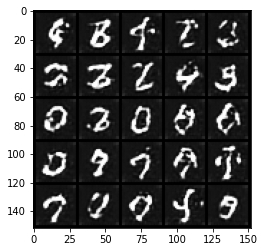

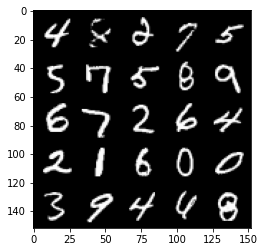

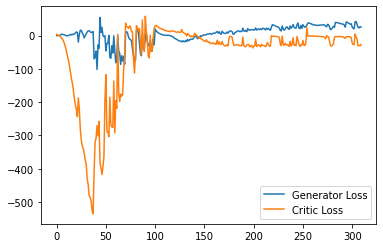

Step 6250: Generator loss: 32.40197780609131, critic loss: -20.803291280746457


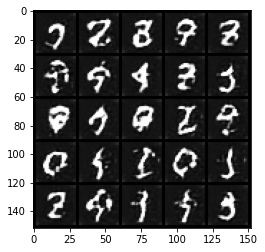

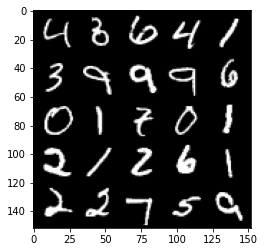

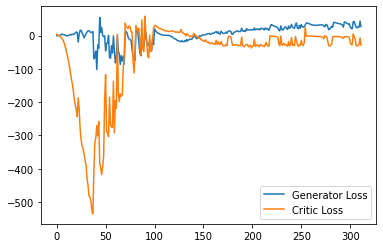

Step 6300: Generator loss: 31.25479700088501, critic loss: -13.838975050926205


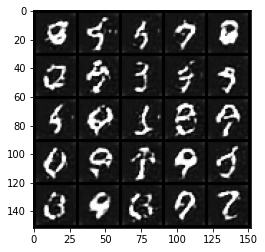

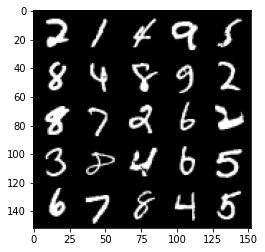

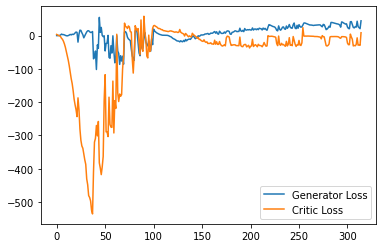

Step 6350: Generator loss: 43.382814254760746, critic loss: -4.055973331451416


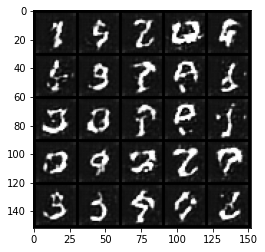

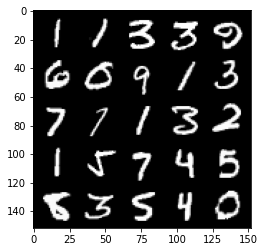

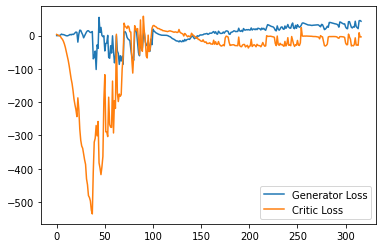

Step 6400: Generator loss: 29.57634624481201, critic loss: -6.912117591857912


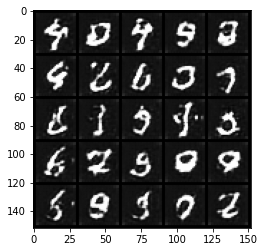

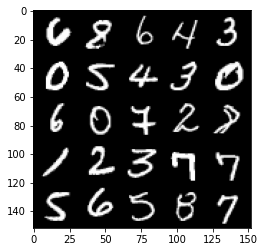

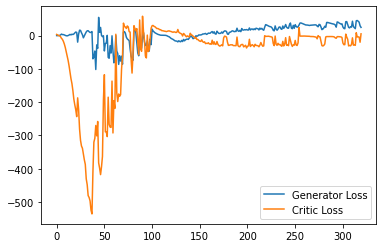

Step 6450: Generator loss: 39.814839363098145, critic loss: -5.392373945713043


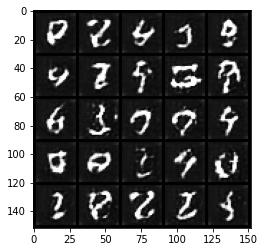

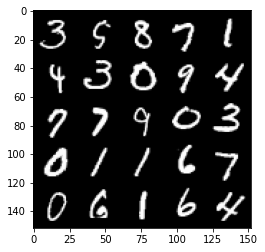

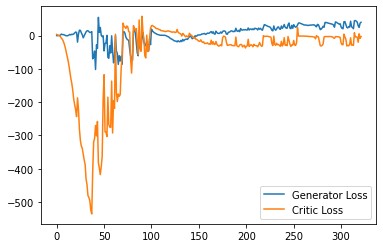

Step 6500: Generator loss: 42.519237747192385, critic loss: -5.1008492126464855


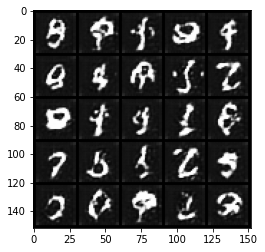

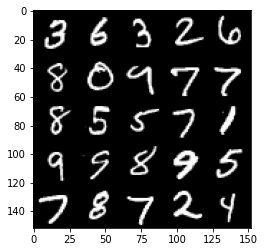

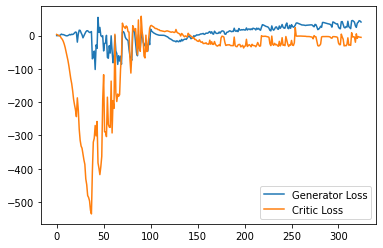

Step 6550: Generator loss: 31.293392429351808, critic loss: -24.579492708206185


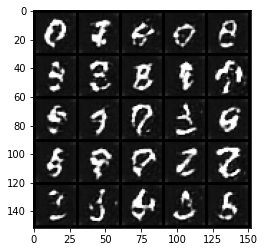

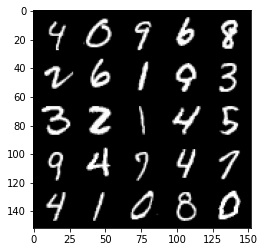

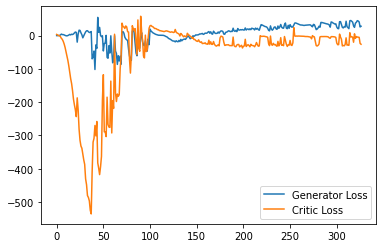

Step 6600: Generator loss: 34.02399181365967, critic loss: -26.586349139213564


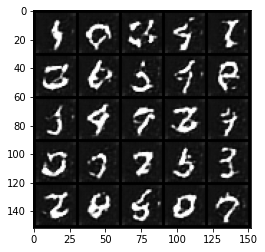

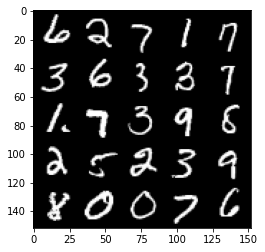

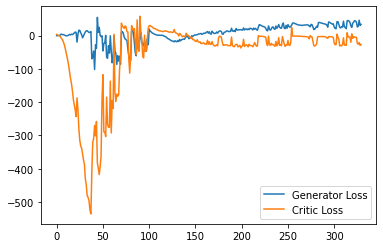

Step 6650: Generator loss: 38.46514106750488, critic loss: -10.498932652950282


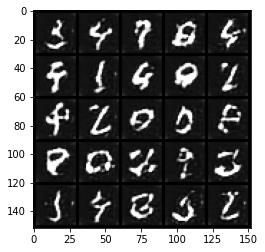

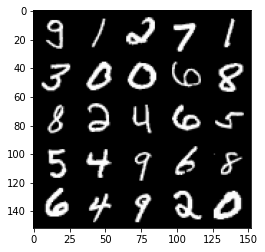

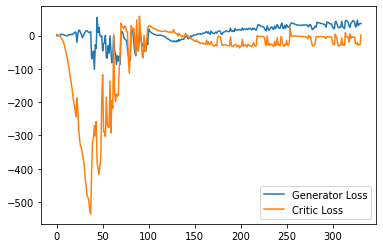

Step 6700: Generator loss: 44.08977584838867, critic loss: -4.298440153837205


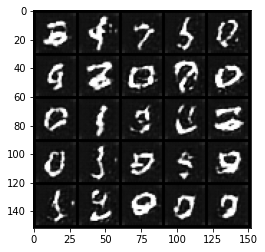

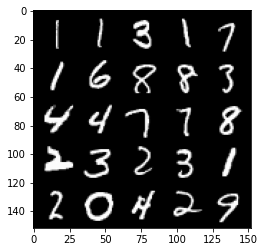

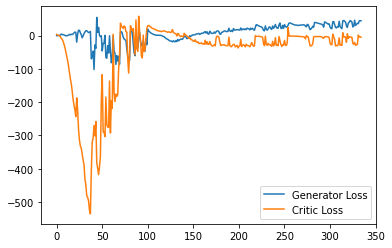

Step 6750: Generator loss: 40.08479637145996, critic loss: -4.936420620918273


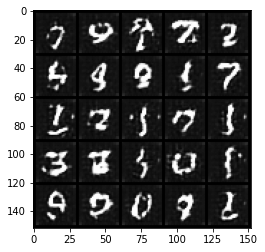

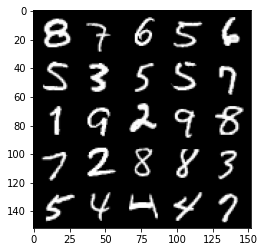

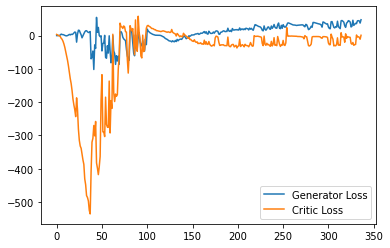

Step 6800: Generator loss: 32.4750594329834, critic loss: -21.572968350410456


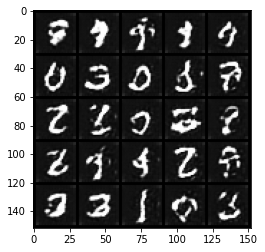

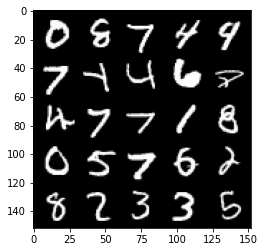

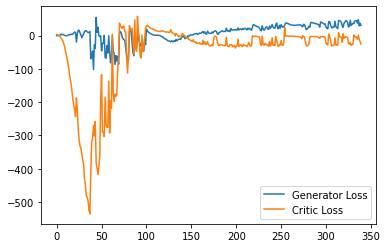

Step 6850: Generator loss: 38.93127487182617, critic loss: -24.183844444274897


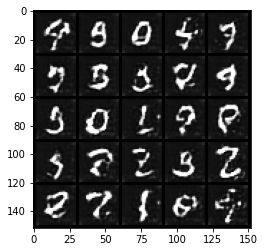

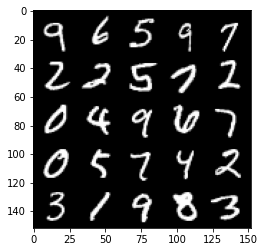

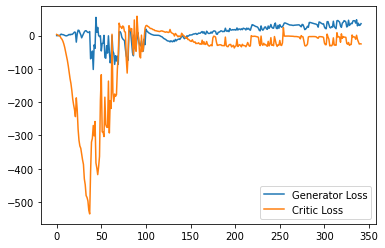

Step 6900: Generator loss: 32.175661430358886, critic loss: -28.074934987068186


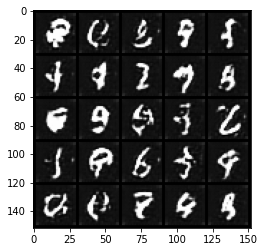

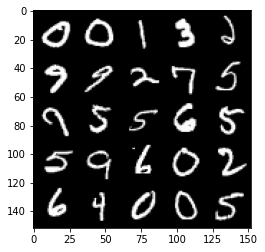

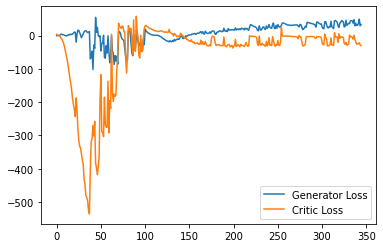

Step 6950: Generator loss: 44.529914932250975, critic loss: -1.1989540777206436


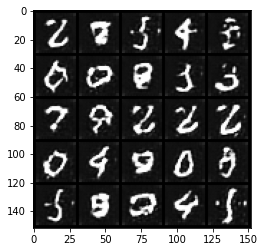

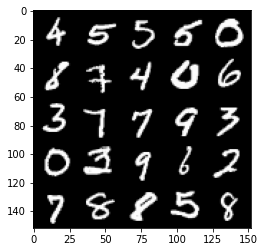

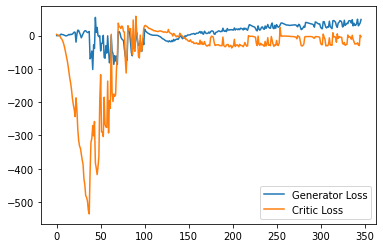

Step 7000: Generator loss: 37.579336128234864, critic loss: -11.782127614974975


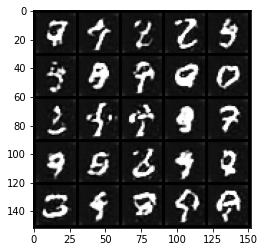

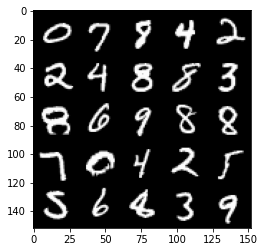

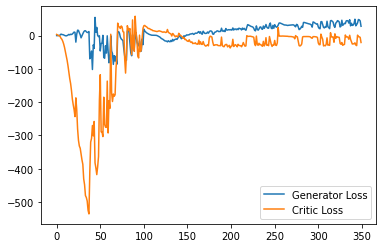

Step 7050: Generator loss: 34.88444557189941, critic loss: -10.998790323734283


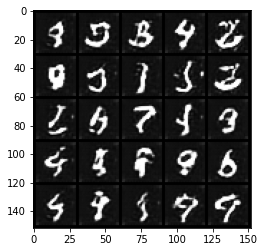

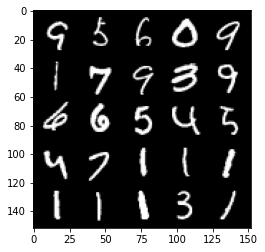

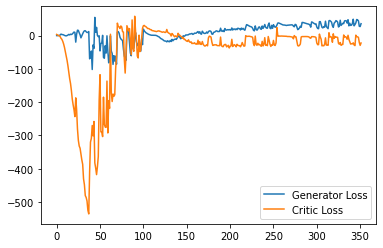

Step 7100: Generator loss: 48.47189315795899, critic loss: -3.439337929725647


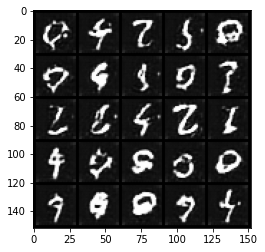

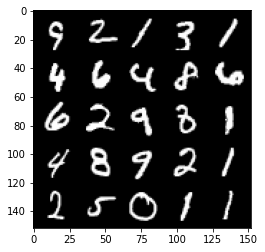

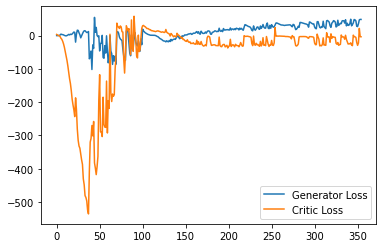

Step 7150: Generator loss: 45.483721618652346, critic loss: -3.8120030145645143


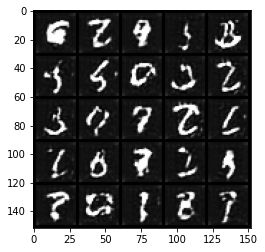

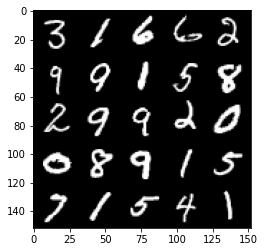

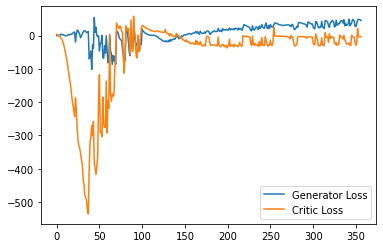

Step 7200: Generator loss: 44.16398239135742, critic loss: -4.357644187927247


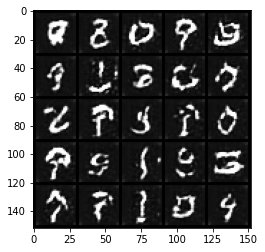

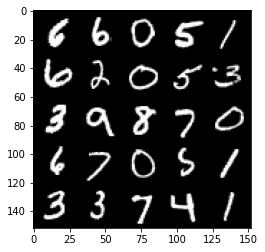

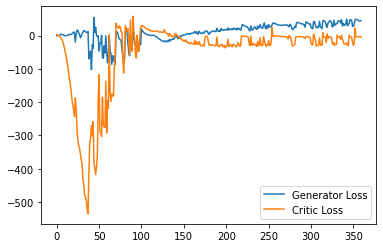

Step 7250: Generator loss: 34.42961097717285, critic loss: -22.024091030597685


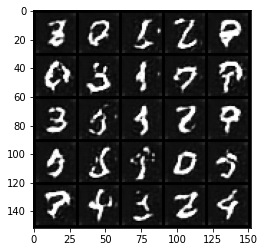

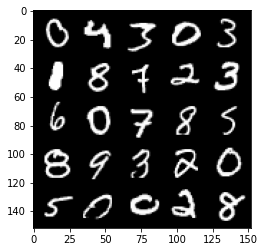

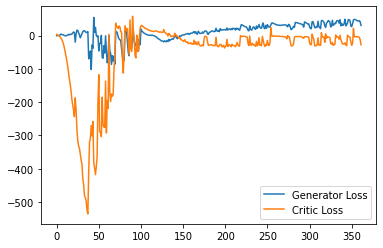

Step 7300: Generator loss: 41.152912063598635, critic loss: -21.755655273437497


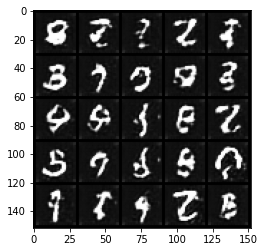

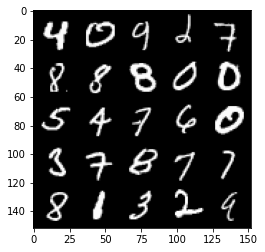

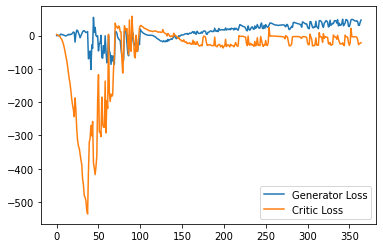

Step 7350: Generator loss: 32.38965961456299, critic loss: -28.11663732147218


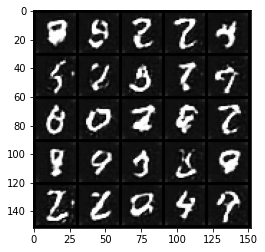

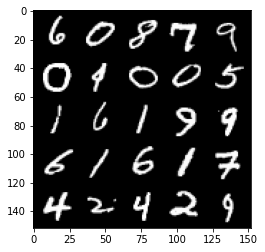

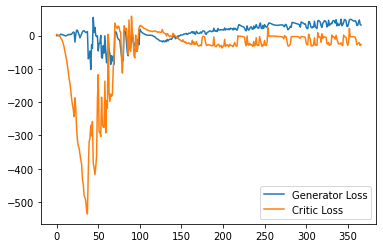

Step 7400: Generator loss: 52.386956939697264, critic loss: 2.4527029032707204


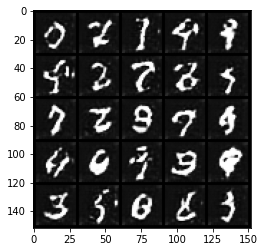

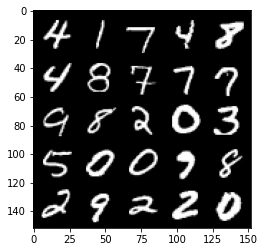

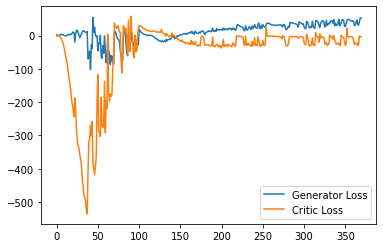

Step 7450: Generator loss: 49.32182586669922, critic loss: -3.407956013679504


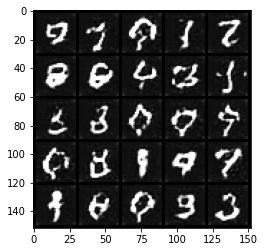

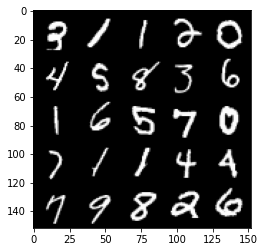

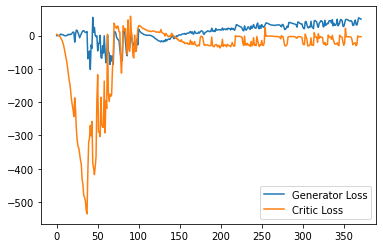

Step 7500: Generator loss: 41.985379486083986, critic loss: -11.80589810848236


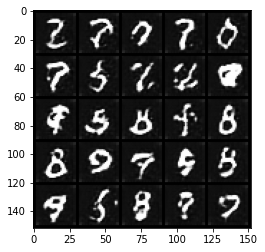

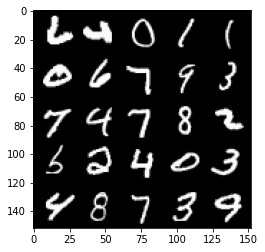

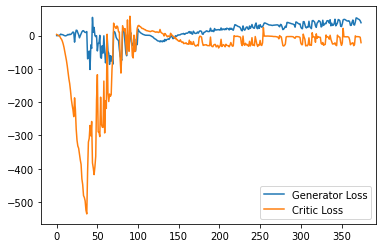

Step 7550: Generator loss: 43.46506828308105, critic loss: 5.105840484142306


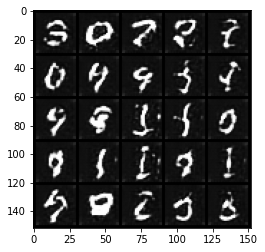

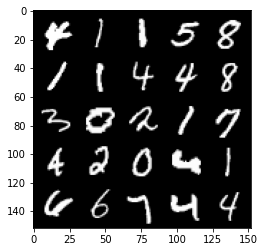

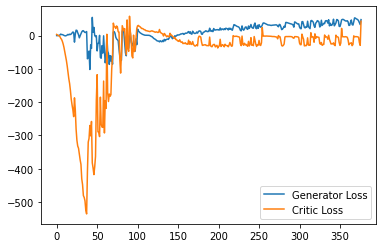

Step 7600: Generator loss: 51.03779426574707, critic loss: -3.0306571083068854


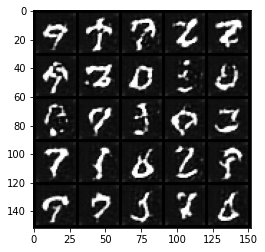

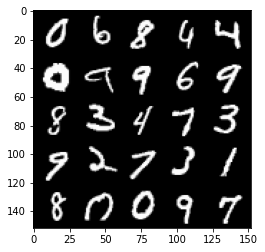

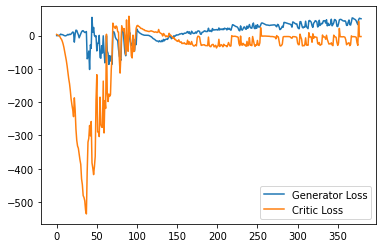

Step 7650: Generator loss: 49.13661582946777, critic loss: -3.2064472789764413


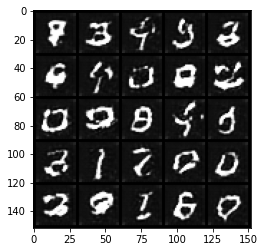

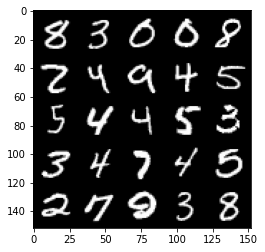

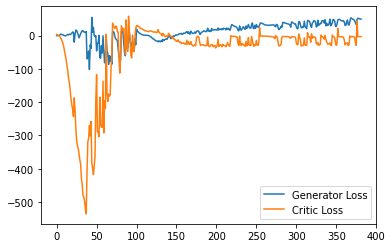

Step 7700: Generator loss: 48.07280265808105, critic loss: -3.4425054006576556


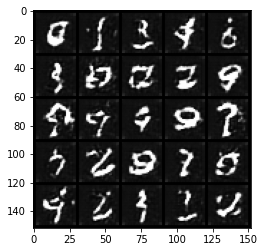

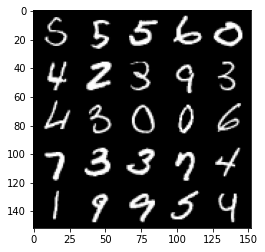

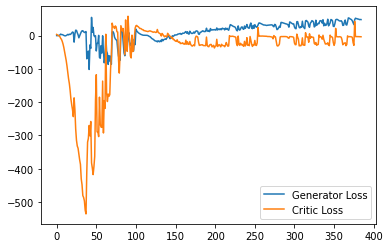

Step 7750: Generator loss: 47.60434791564941, critic loss: -4.347289659500123


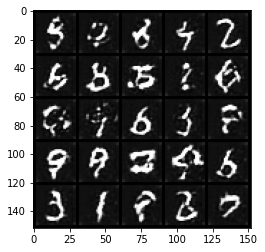

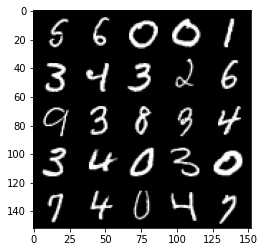

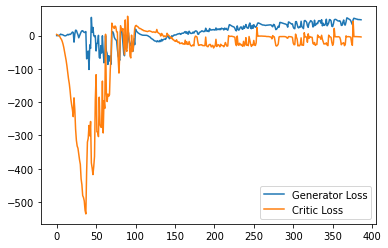

Step 7800: Generator loss: 40.139716148376465, critic loss: -21.630990965843193


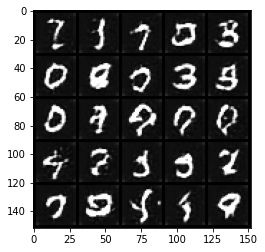

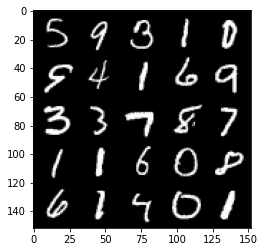

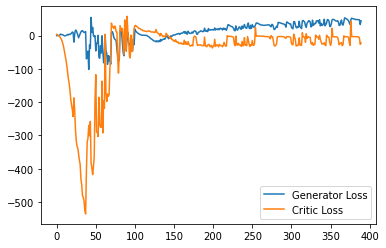

Step 7850: Generator loss: 43.39160568237305, critic loss: -17.06312455892563


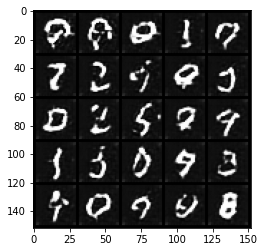

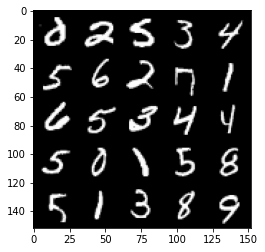

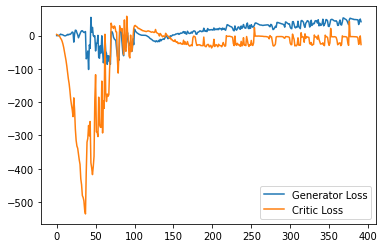

Step 7900: Generator loss: 41.45083576202393, critic loss: -25.057218942642212


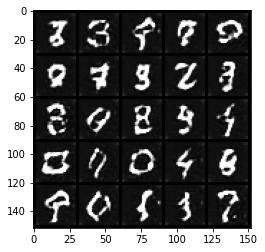

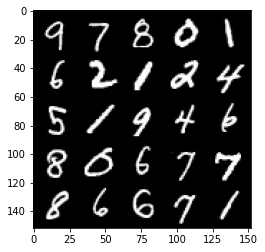

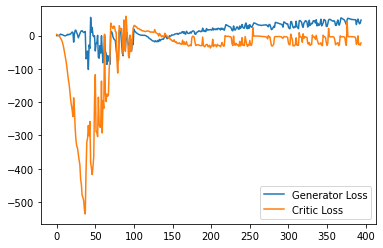

Step 7950: Generator loss: 42.03464389801025, critic loss: -24.370925658226014


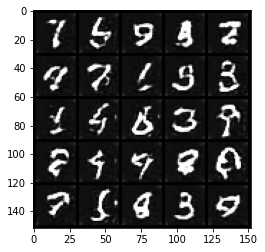

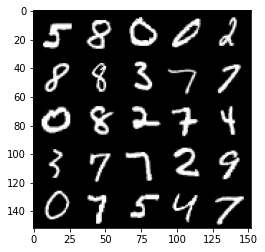

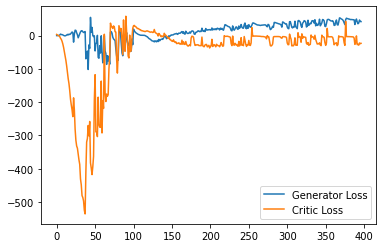

Step 8000: Generator loss: 41.73528621673584, critic loss: -21.19143142604828


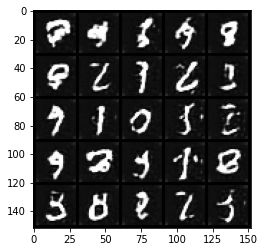

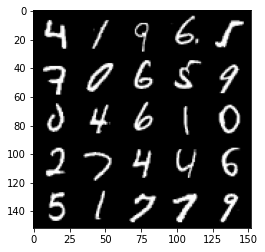

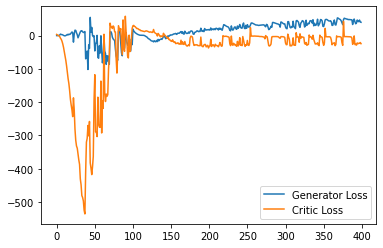

Step 8050: Generator loss: 43.29142406463623, critic loss: -22.926445570945738


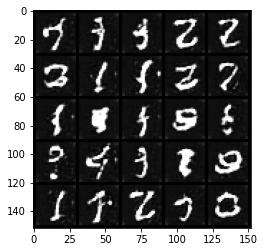

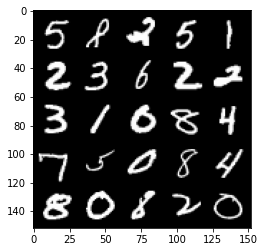

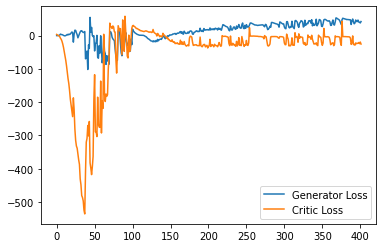

Step 8100: Generator loss: 44.97978500366211, critic loss: 1.3011163973808342


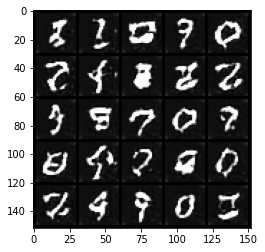

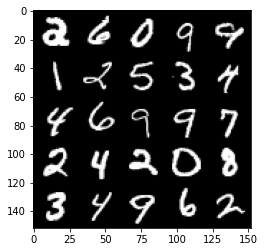

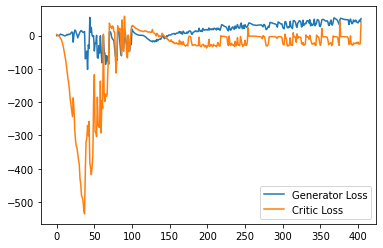

Step 8150: Generator loss: 55.110083770751956, critic loss: -2.6285874466896058


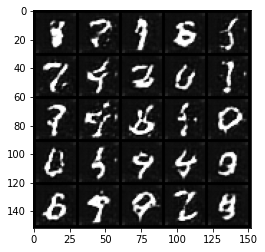

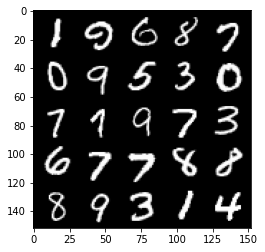

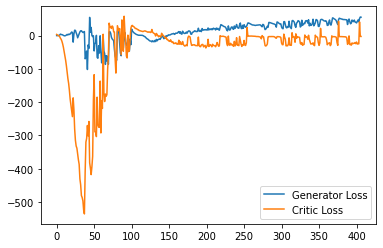

Step 8200: Generator loss: 53.213774795532224, critic loss: -2.6528986706733706


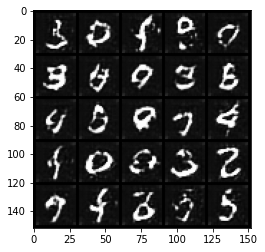

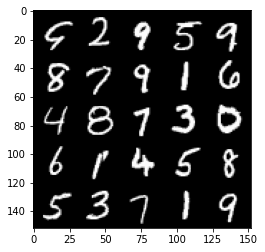

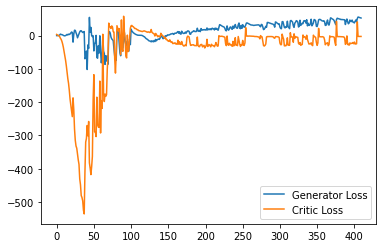

Step 8250: Generator loss: 51.72029113769531, critic loss: -2.8405247802734372


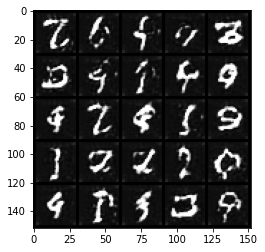

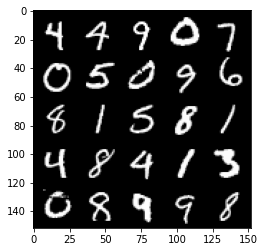

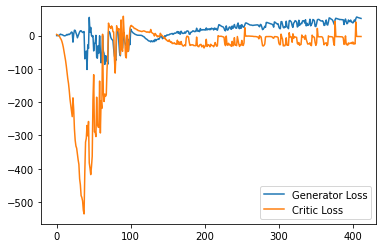

Step 8300: Generator loss: 51.08821334838867, critic loss: -3.0351182079315184


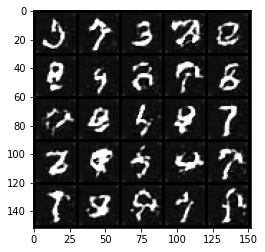

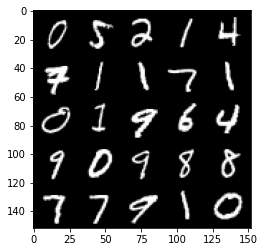

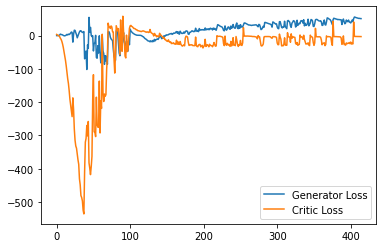

Step 8350: Generator loss: 49.98274353027344, critic loss: -3.1422471265792846


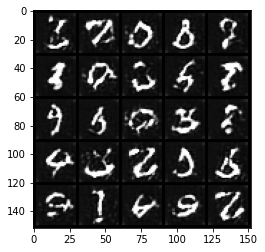

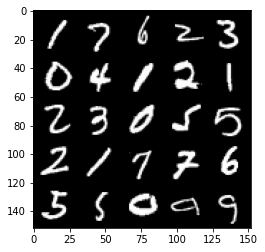

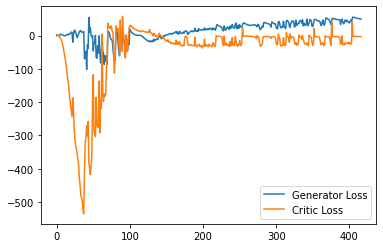

Step 8400: Generator loss: 48.749145889282225, critic loss: -3.650054904937744


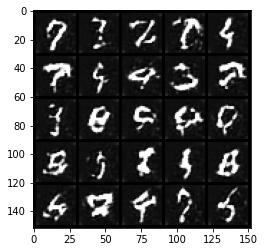

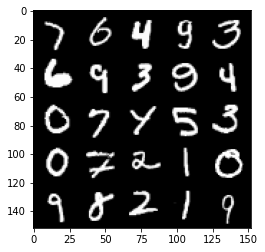

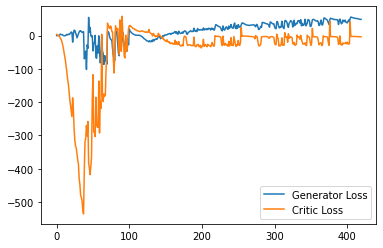

Step 8450: Generator loss: 45.887476119995114, critic loss: -9.524816234588622


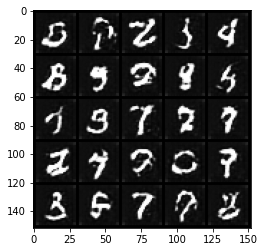

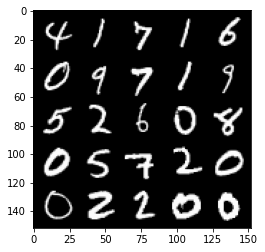

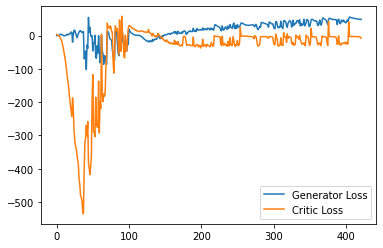

Step 8500: Generator loss: 38.53384635925293, critic loss: -12.451181943416595


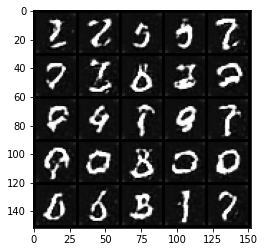

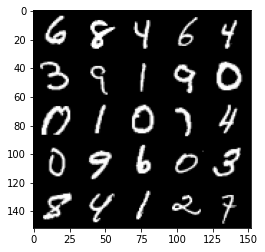

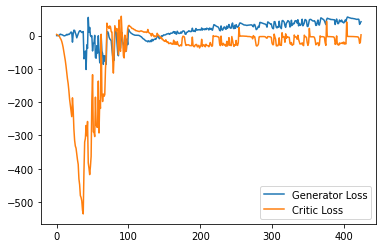

Step 8550: Generator loss: 38.74430908203125, critic loss: -23.024186857700347


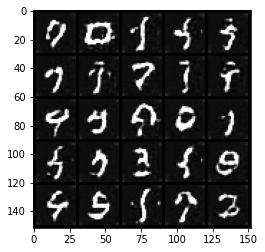

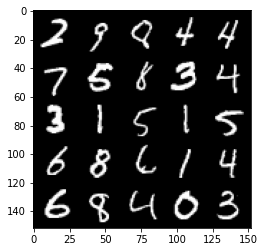

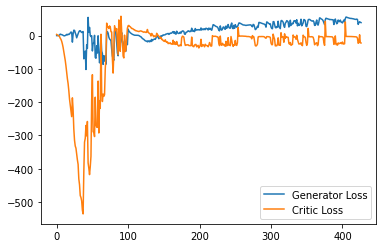

Step 8600: Generator loss: 47.63517845153809, critic loss: -18.99437952947617


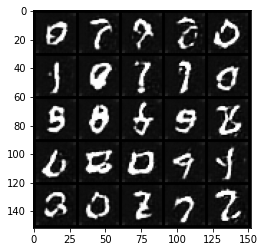

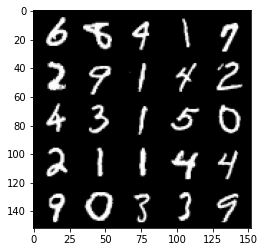

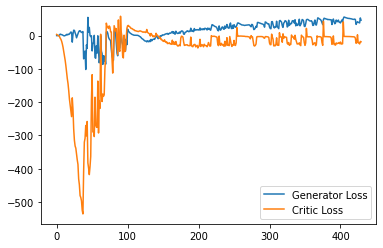

Step 8650: Generator loss: 44.486777267456056, critic loss: -21.806074601650238


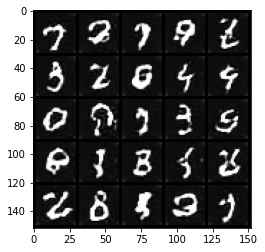

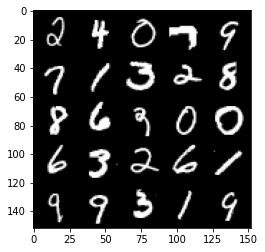

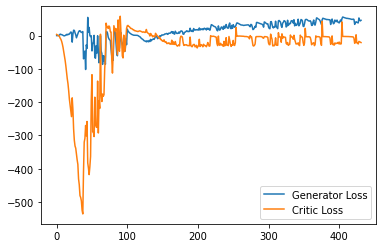

Step 8700: Generator loss: 49.05727899312973, critic loss: -10.126727745056154


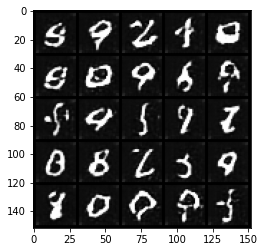

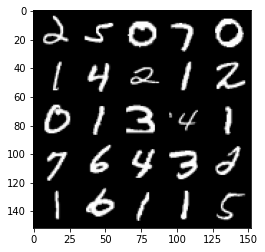

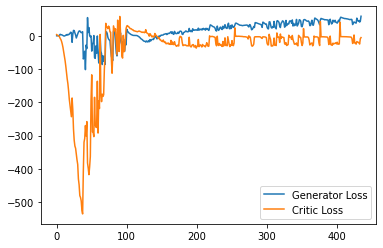

Step 8750: Generator loss: 54.41886093139649, critic loss: -13.148667084693912


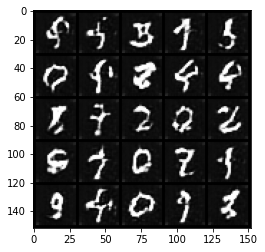

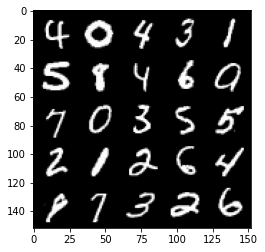

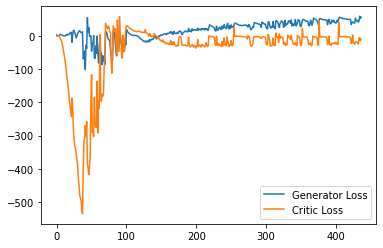

Step 8800: Generator loss: 44.85735984802246, critic loss: -20.542418442726138


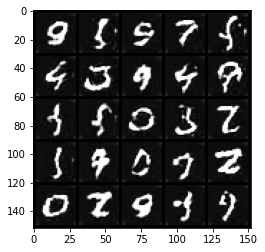

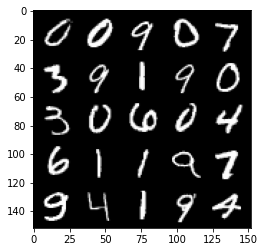

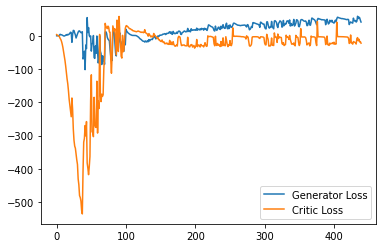

Step 8850: Generator loss: 48.06991798400879, critic loss: -22.81678680229188


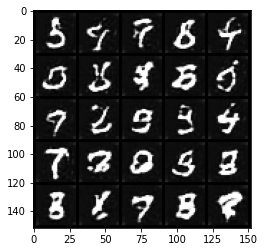

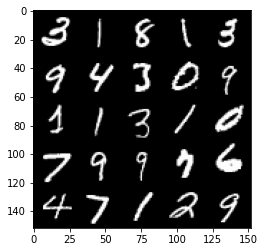

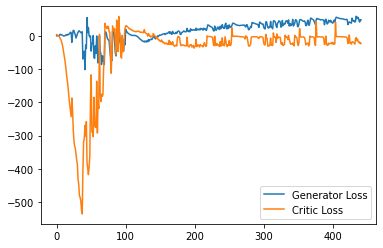

Step 8900: Generator loss: 54.30150817871094, critic loss: 11.529279190063475


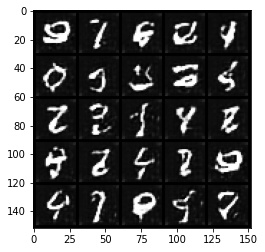

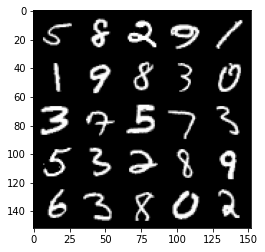

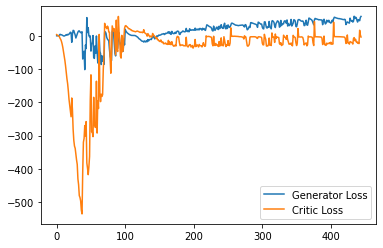

Step 8950: Generator loss: 57.213922348022464, critic loss: -4.4306713819503765


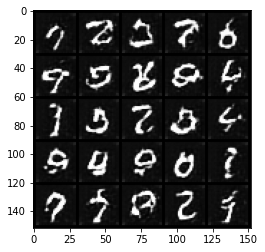

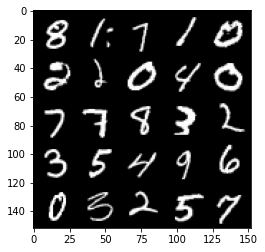

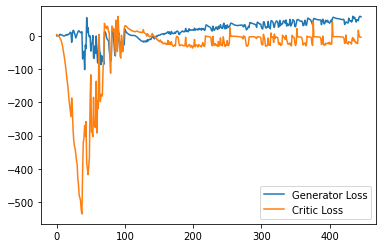

Step 9000: Generator loss: 51.12914543151855, critic loss: -11.347814266204834


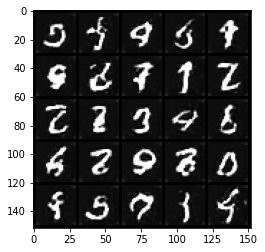

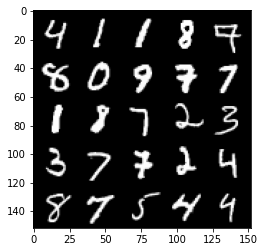

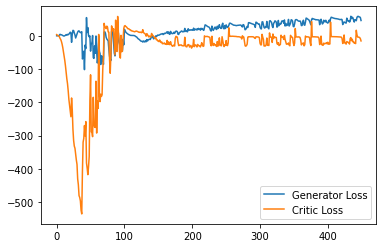

Step 9050: Generator loss: 52.067919158935545, critic loss: -17.744951989173888


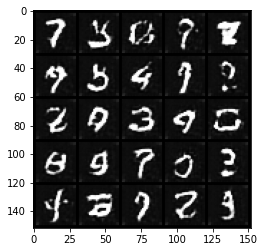

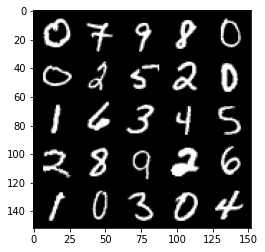

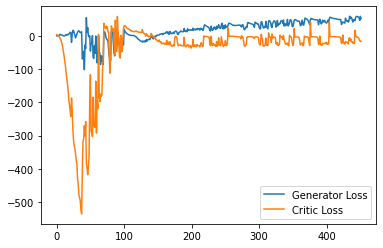

Step 9100: Generator loss: 45.7314270401001, critic loss: -20.706126483440404


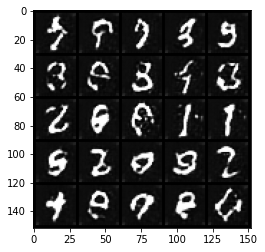

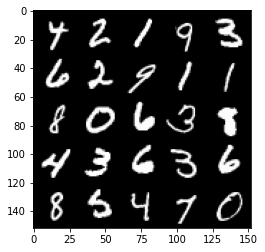

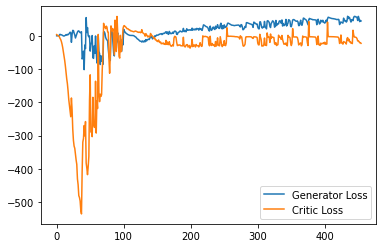

Step 9150: Generator loss: 47.96839412689209, critic loss: -19.946188780784606


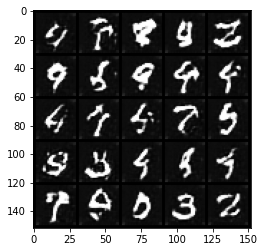

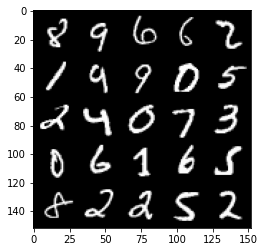

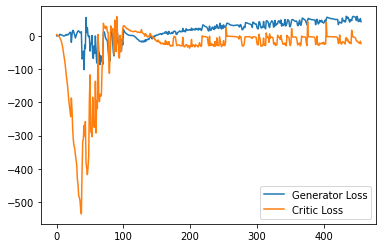

Step 9200: Generator loss: 45.63716453552246, critic loss: -26.259780914783473


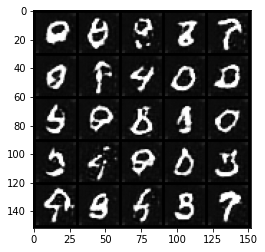

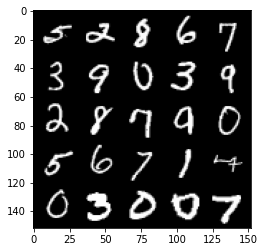

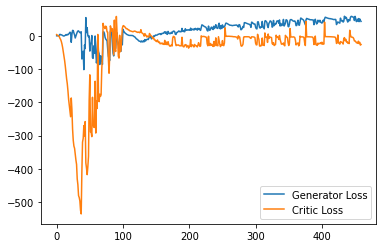

Step 9250: Generator loss: 53.56147674560547, critic loss: -18.631268628120424


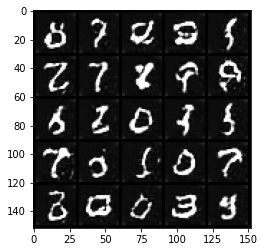

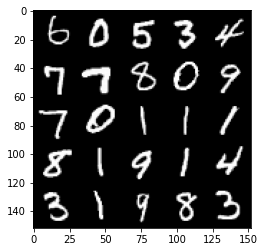

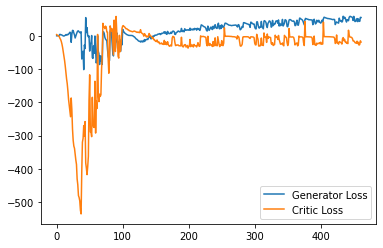

Step 9300: Generator loss: 55.66392227172852, critic loss: -4.700909412860869


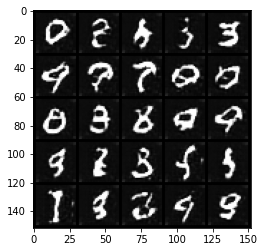

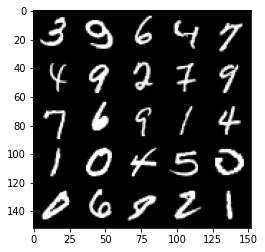

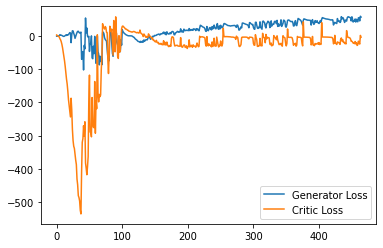

Step 9350: Generator loss: 48.551321792602536, critic loss: -16.103718218803404


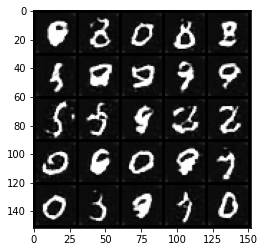

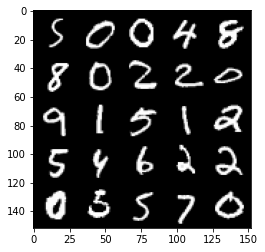

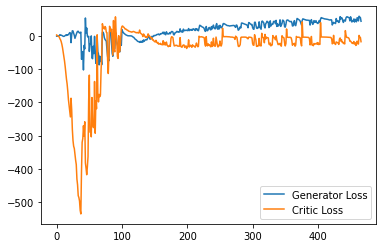

Step 9400: Generator loss: 47.95254661560059, critic loss: -13.28431288385391


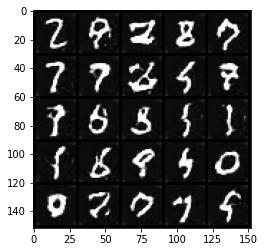

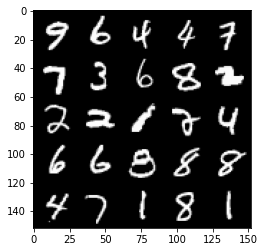

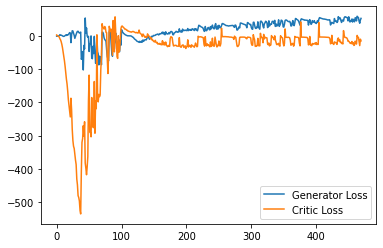

Step 9450: Generator loss: 46.35403106689453, critic loss: -24.330573115348813


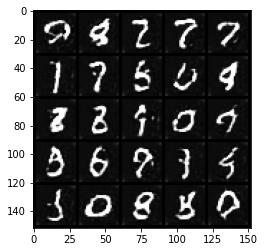

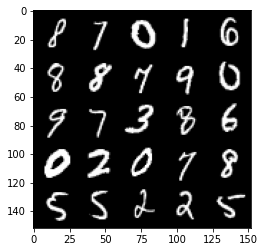

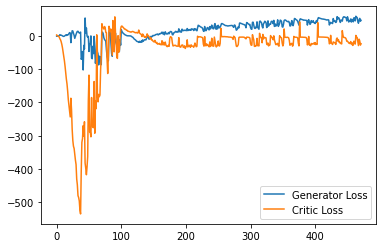

Step 9500: Generator loss: 53.407726516723635, critic loss: -18.922972969055174


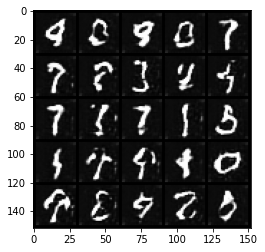

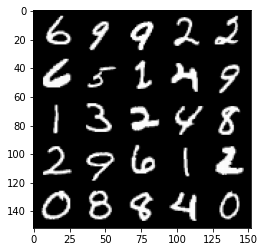

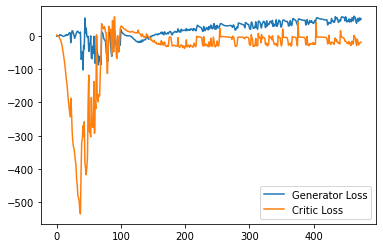

Step 9550: Generator loss: 51.389779052734376, critic loss: -19.29027270841598


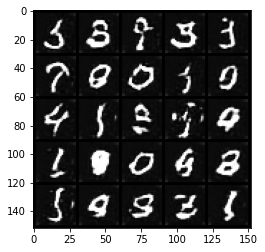

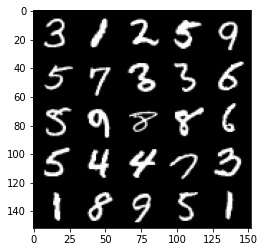

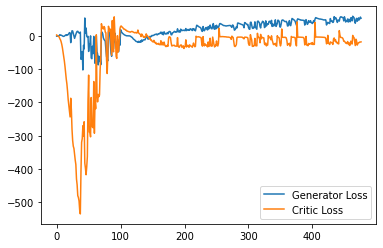

Step 9600: Generator loss: 57.07304565429688, critic loss: -5.749070654869078


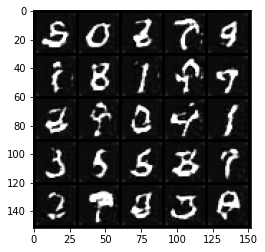

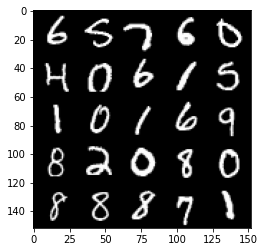

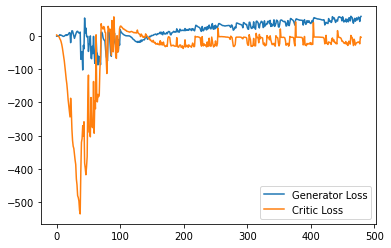

Step 9650: Generator loss: 56.93470458984375, critic loss: -4.919522359848021


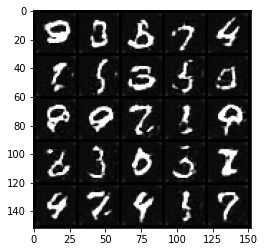

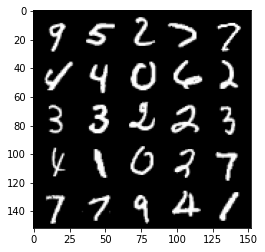

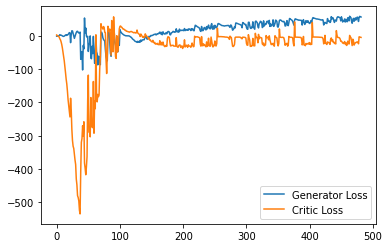

Step 9700: Generator loss: 52.72790679931641, critic loss: 1.0341235780715938


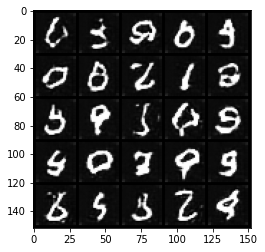

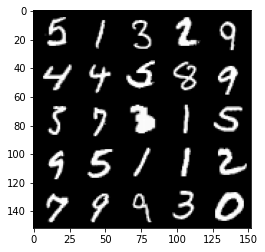

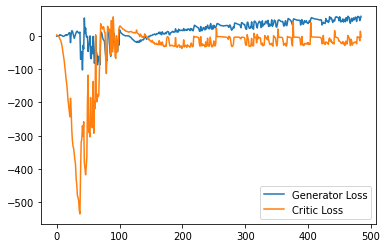

Step 9750: Generator loss: 46.96281047821045, critic loss: -17.469803731918333


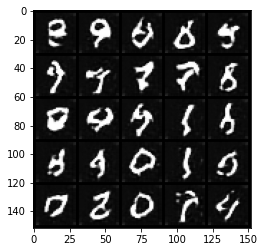

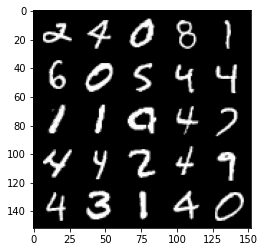

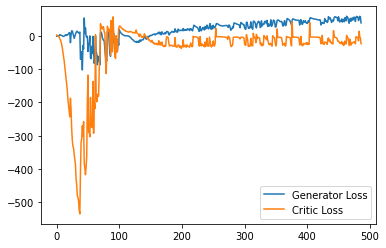

Step 9800: Generator loss: 51.203708457946775, critic loss: -21.078907730579377


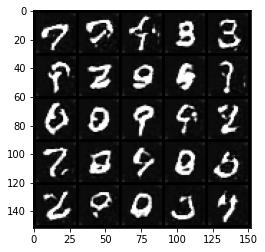

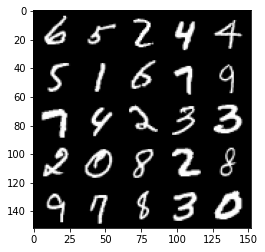

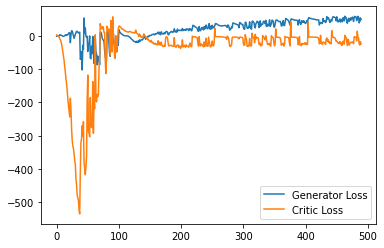

Step 9850: Generator loss: 47.326995315551756, critic loss: -23.083982848167423


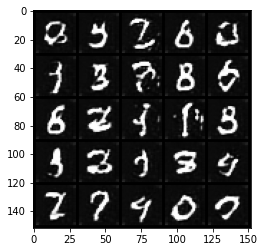

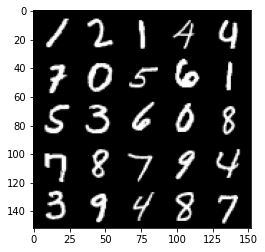

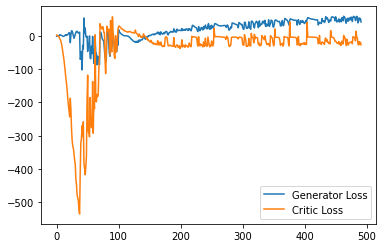

Step 9900: Generator loss: 47.07252918243408, critic loss: -23.191140014648436


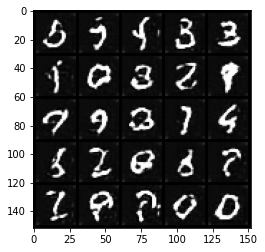

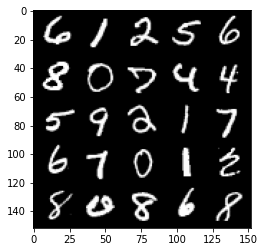

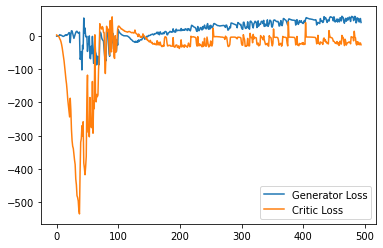

Step 9950: Generator loss: 52.49557693481445, critic loss: -4.950964544296266


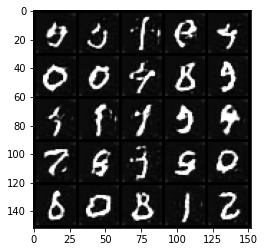

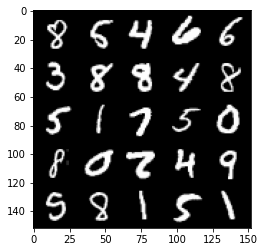

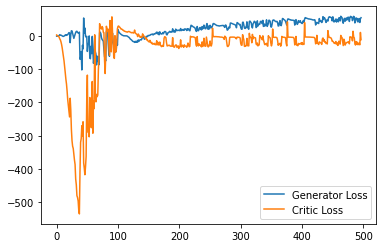

Step 10000: Generator loss: 45.98148933410644, critic loss: -21.529166324138643


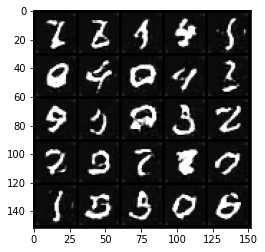

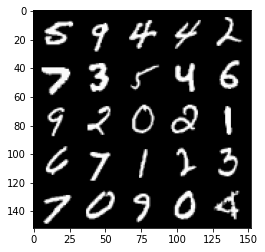

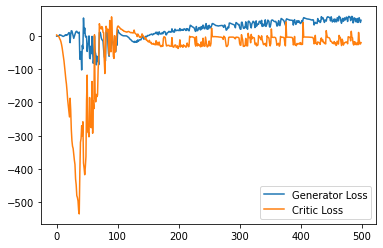

Step 10050: Generator loss: 57.00994171142578, critic loss: -21.983247798919674


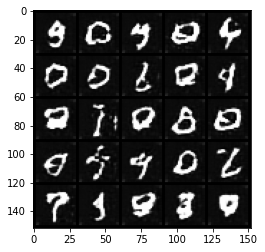

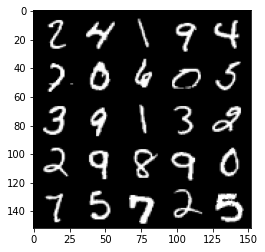

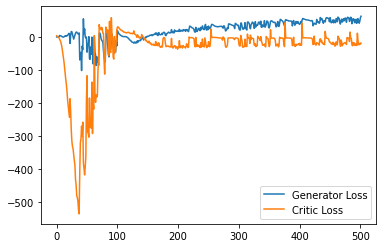

Step 10100: Generator loss: 51.95192886352539, critic loss: -26.212478224754335


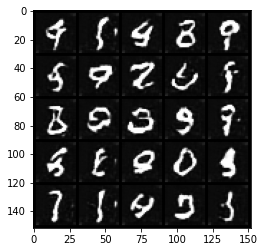

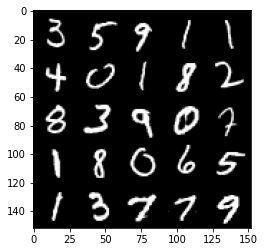

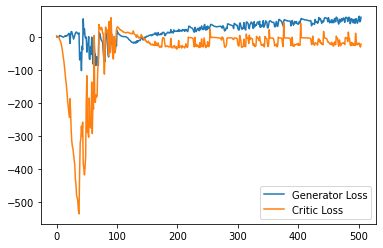

Step 10150: Generator loss: 58.00951602935791, critic loss: -22.482517199754707


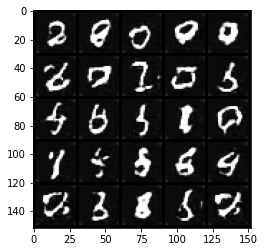

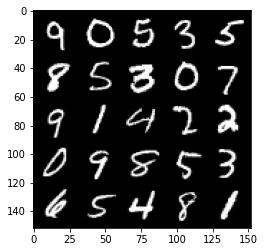

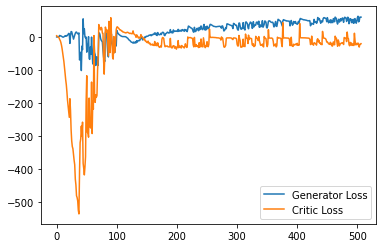

Step 10200: Generator loss: 57.03030029296875, critic loss: -18.925632276535033


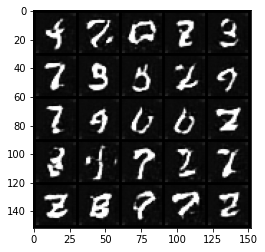

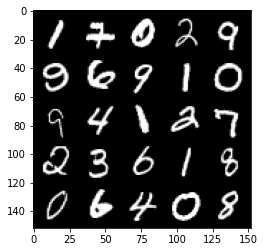

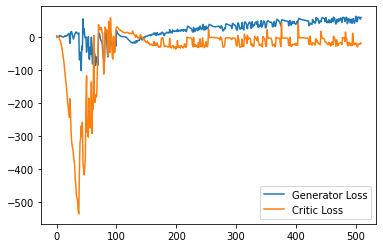

Step 10250: Generator loss: 59.478466186523434, critic loss: -16.040859060287474


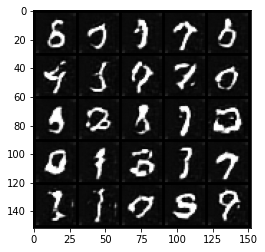

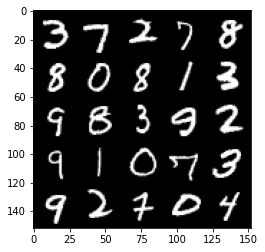

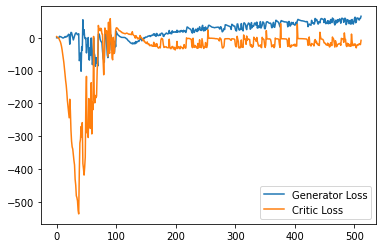

Step 10300: Generator loss: 50.04396389007568, critic loss: -16.94216506290436


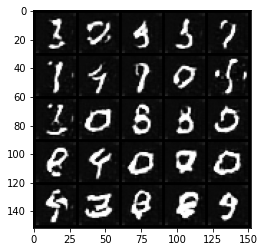

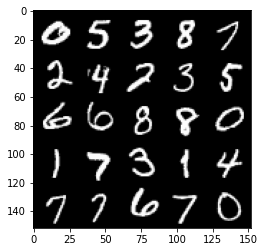

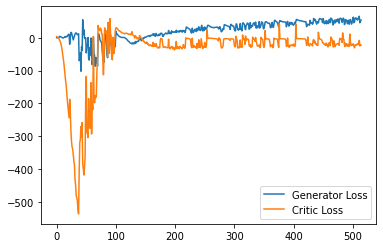

Step 10350: Generator loss: 61.06224639892578, critic loss: -8.225526803970338


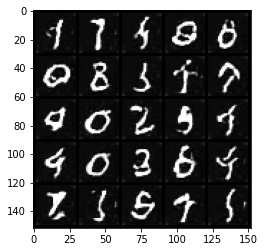

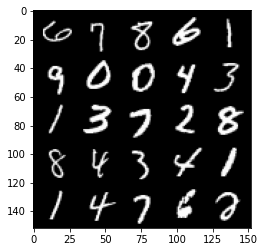

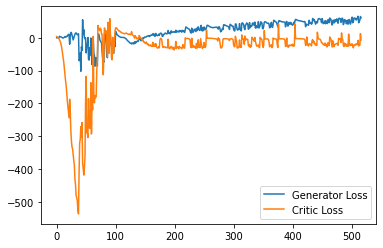

Step 10400: Generator loss: 53.28606910705567, critic loss: -21.34582613801956


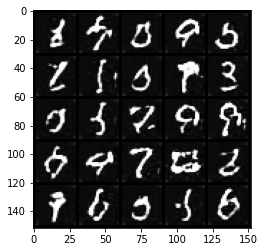

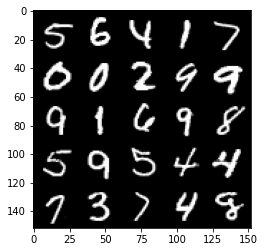

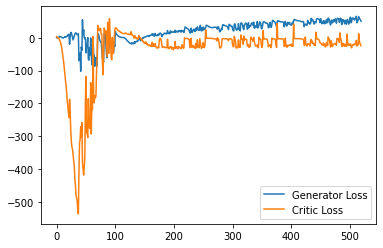

Step 10450: Generator loss: 56.44025680541992, critic loss: -21.433532711029056


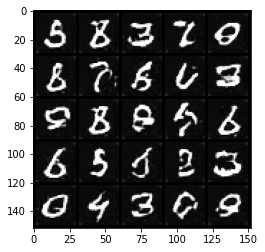

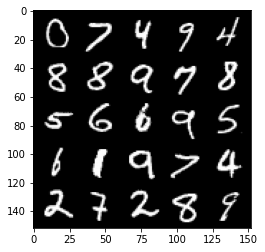

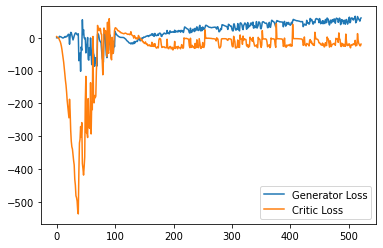

Step 10500: Generator loss: 58.699385223388674, critic loss: -22.619003680229188


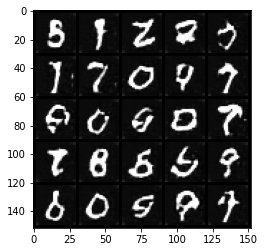

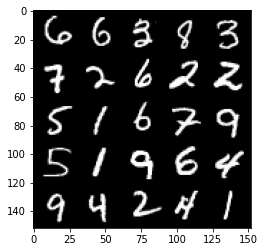

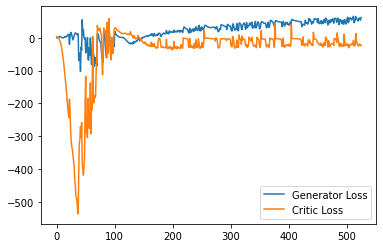

Step 10550: Generator loss: 51.368111801147464, critic loss: -27.244748536586766


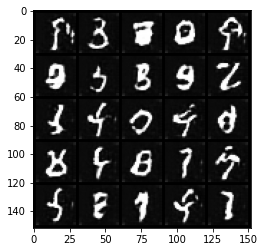

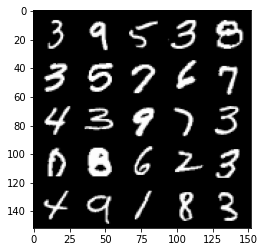

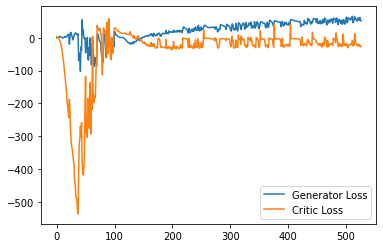

Step 10600: Generator loss: 63.895683212280275, critic loss: 6.271041452884674


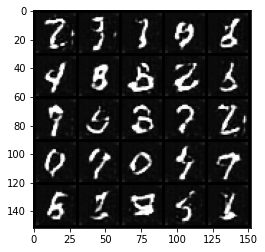

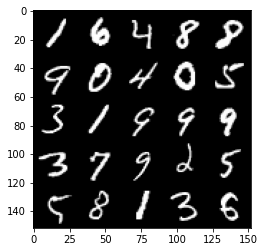

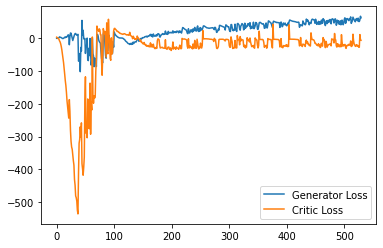

Step 10650: Generator loss: 64.60708755493164, critic loss: -13.669229073524482


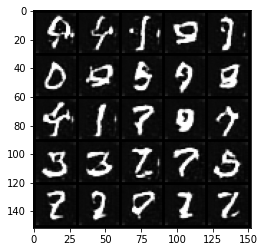

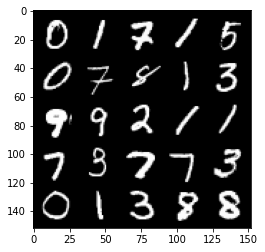

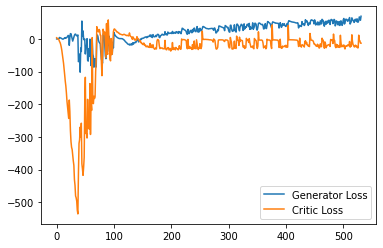

Step 10700: Generator loss: 58.91158058166504, critic loss: -18.079067329883582


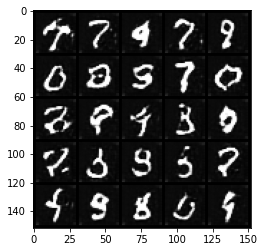

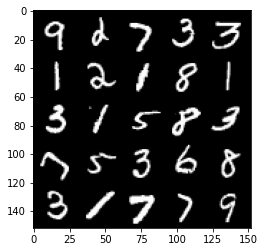

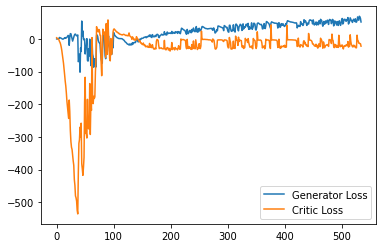

Step 10750: Generator loss: 55.69863597869873, critic loss: -20.677980480670925


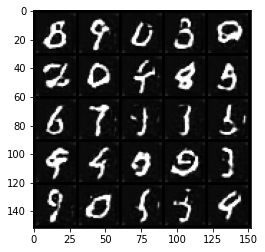

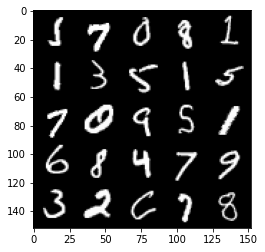

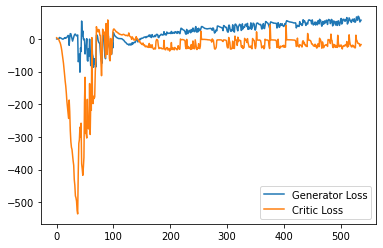

Step 10800: Generator loss: 62.519227828979496, critic loss: -19.571590092658997


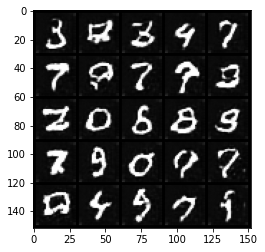

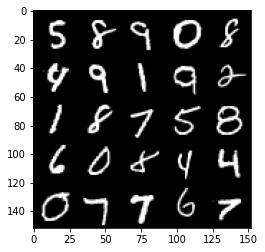

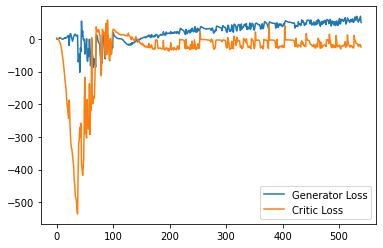

Step 10850: Generator loss: 55.53996055603027, critic loss: -22.7476100730896


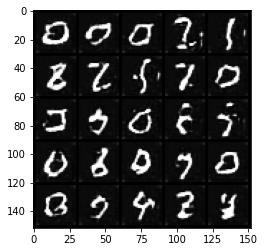

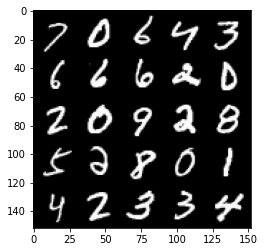

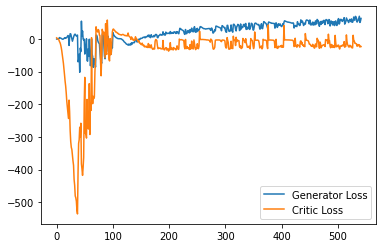

Step 10900: Generator loss: 67.53316551208496, critic loss: -19.241744510650634


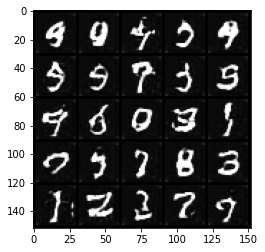

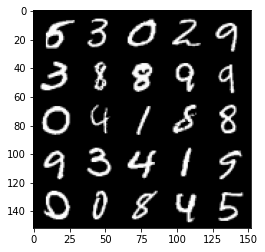

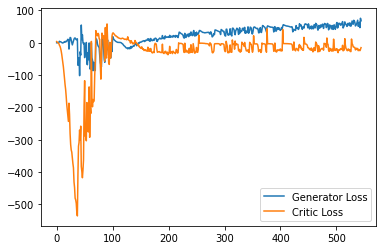

Step 10950: Generator loss: 59.932559204101565, critic loss: -19.235337161064148


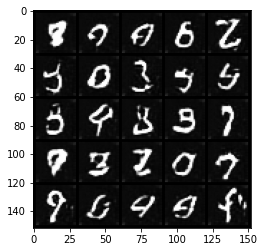

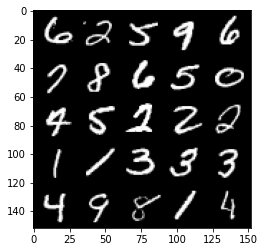

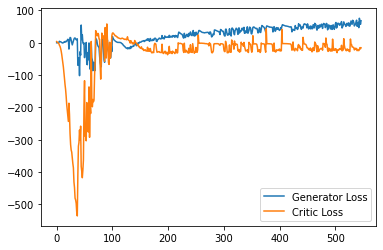

Step 11000: Generator loss: 56.8209529876709, critic loss: -20.960462665557866


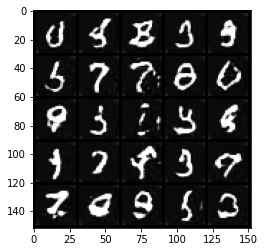

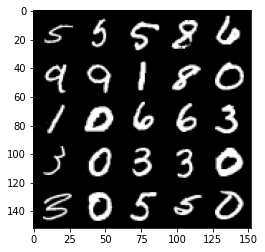

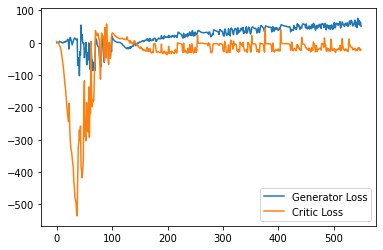

Step 11050: Generator loss: 69.95347564697266, critic loss: 5.317249197483062


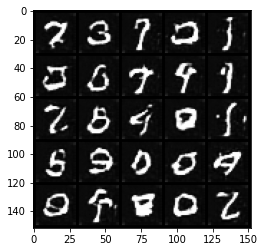

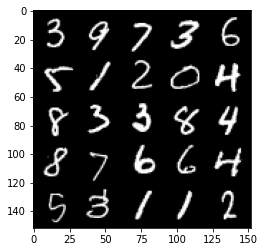

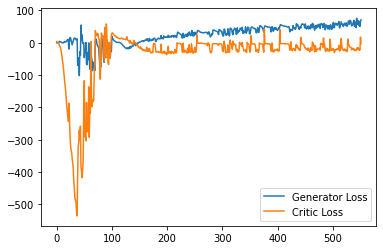

Step 11100: Generator loss: 69.13101455688476, critic loss: -3.130093503952027


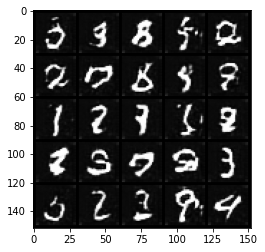

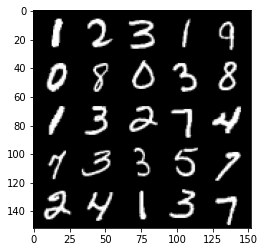

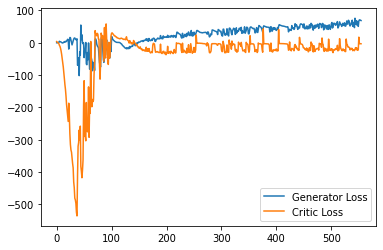

Step 11150: Generator loss: 66.13812530517578, critic loss: -3.599348528861999


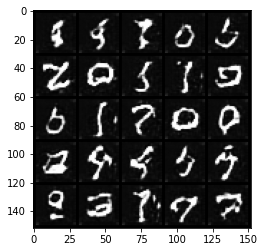

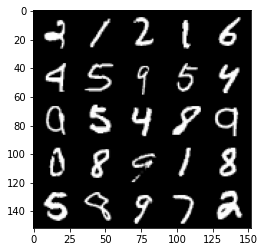

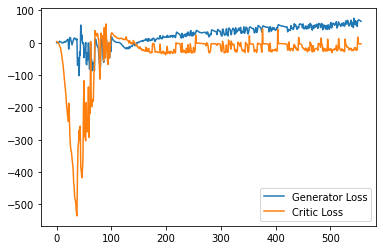

Step 11200: Generator loss: 63.86879531860352, critic loss: -9.310174118041992


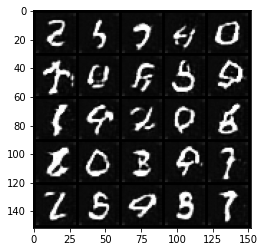

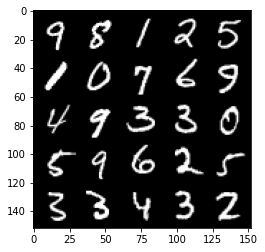

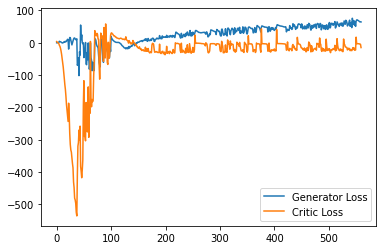

Step 11250: Generator loss: 55.09836303710937, critic loss: -21.171247927665707


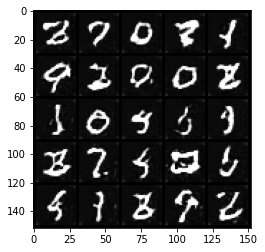

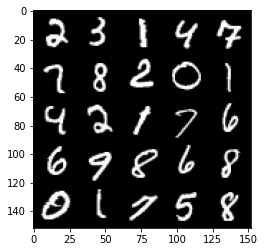

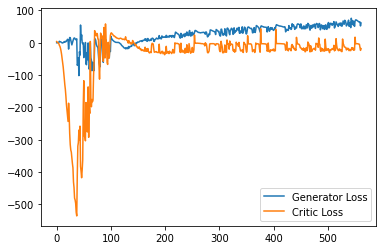

Step 11300: Generator loss: 56.8976505279541, critic loss: -22.77353457880021


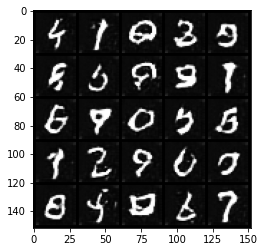

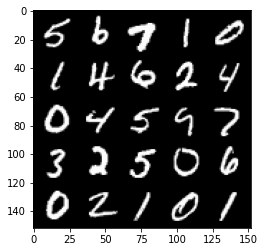

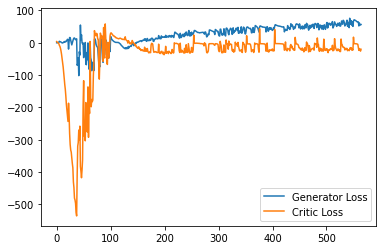

Step 11350: Generator loss: 63.45043979644775, critic loss: -6.447692420482635


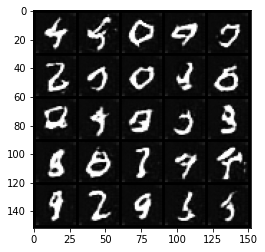

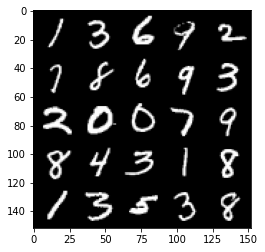

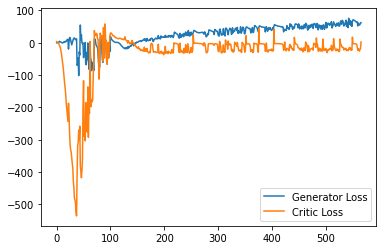

Step 11400: Generator loss: 70.72841094970703, critic loss: -3.096325238227845


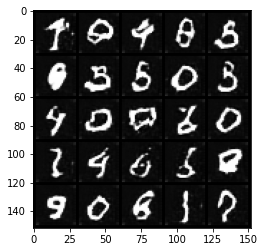

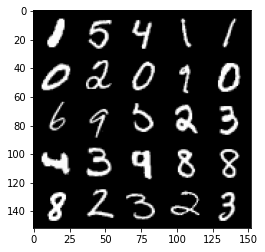

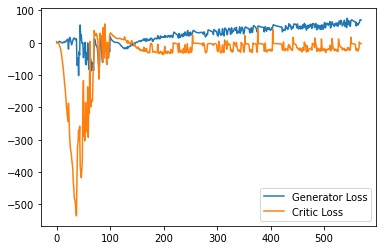

Step 11450: Generator loss: 68.04054504394531, critic loss: -3.8664225368499756


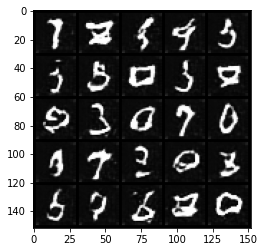

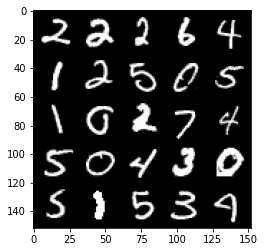

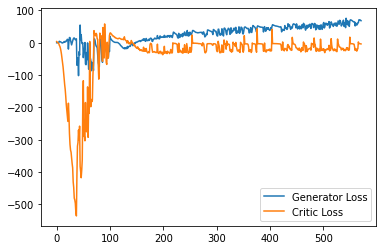

Step 11500: Generator loss: 62.80184585571289, critic loss: 5.05900609922409


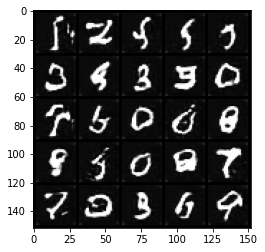

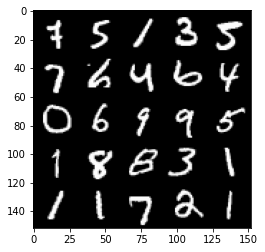

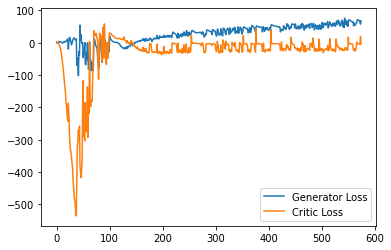

Step 11550: Generator loss: 68.44506118774414, critic loss: -3.845893936157226


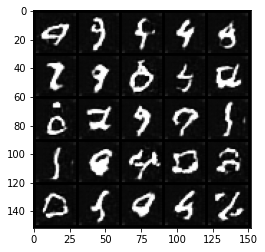

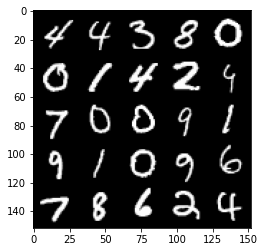

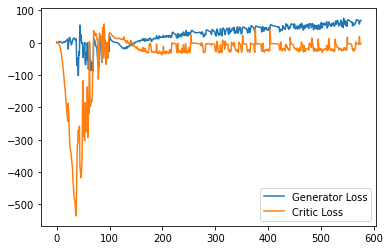

Step 11600: Generator loss: 65.85107757568359, critic loss: -4.7883680143356315


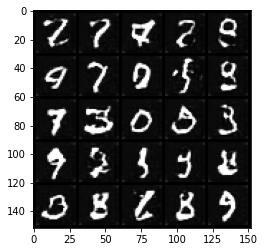

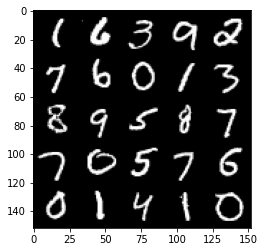

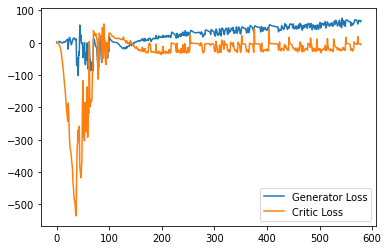

Step 11650: Generator loss: 54.281456298828125, critic loss: -21.100277323246004


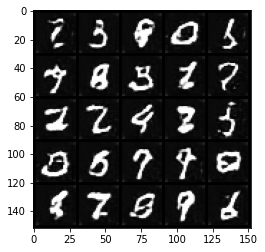

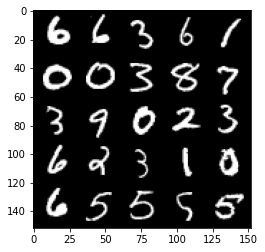

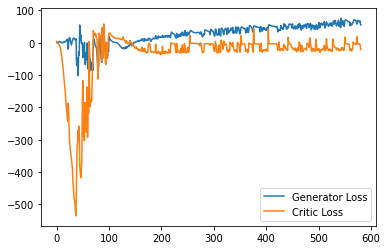

Step 11700: Generator loss: 60.72814651489258, critic loss: -20.390557210445408


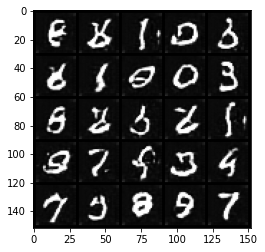

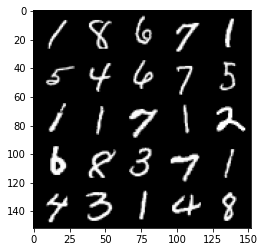

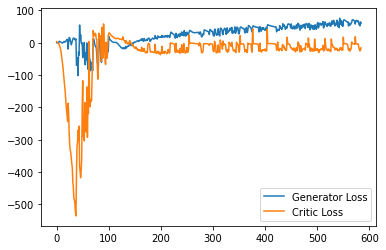

Step 11750: Generator loss: 67.12038513183593, critic loss: -16.974569524765013


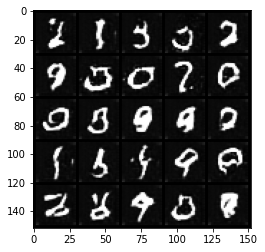

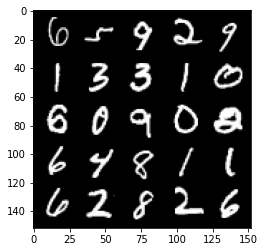

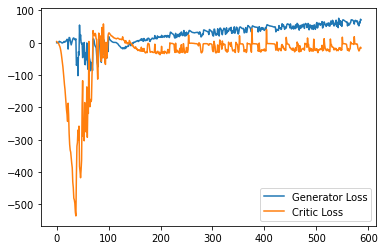

Step 11800: Generator loss: 66.1589655303955, critic loss: -17.695716687202456


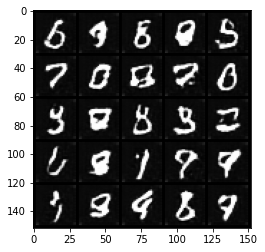

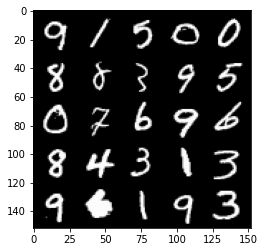

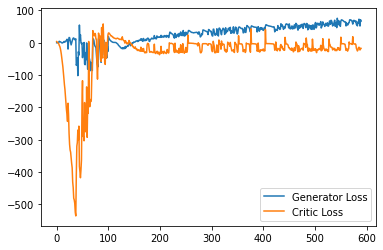

Step 11850: Generator loss: 56.34999649047852, critic loss: -25.64454858589172


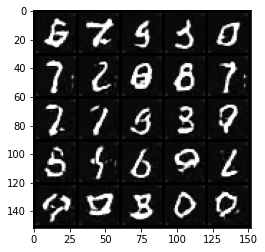

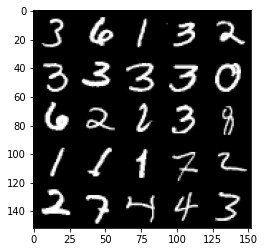

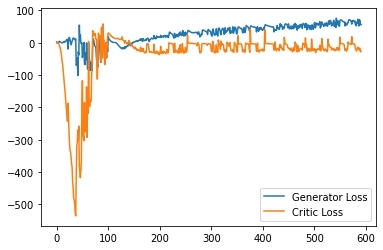

Step 11900: Generator loss: 68.9977855682373, critic loss: -1.2740685887336738


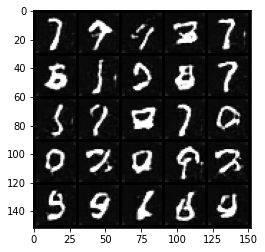

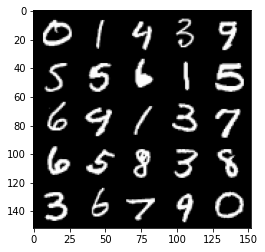

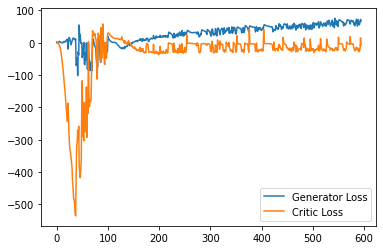

Step 11950: Generator loss: 63.39812705993652, critic loss: -16.16500934791565


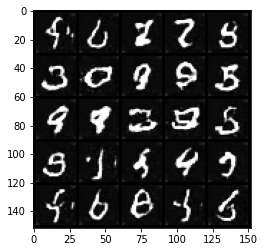

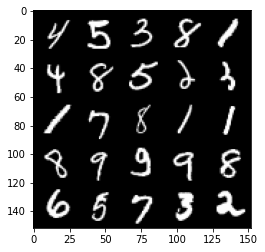

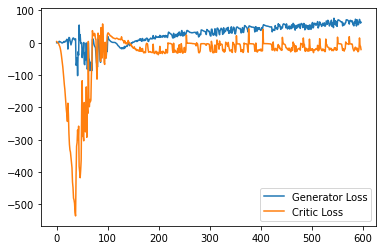

Step 12000: Generator loss: 68.16309883117675, critic loss: -18.826448447227477


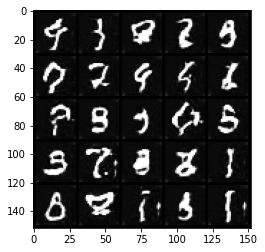

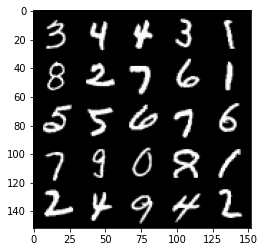

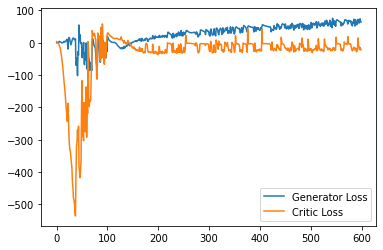

Step 12050: Generator loss: 66.61198150634766, critic loss: -18.651774094104766


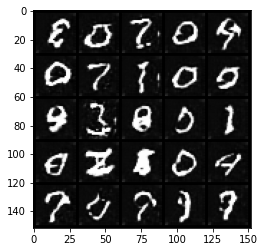

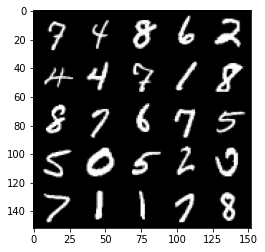

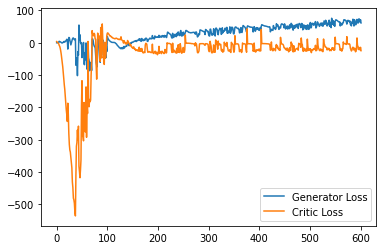

Step 12100: Generator loss: 75.50791526794434, critic loss: -11.752282538414004


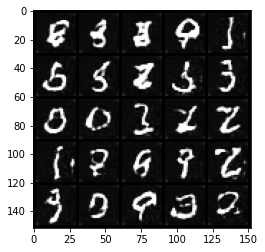

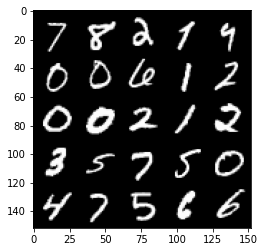

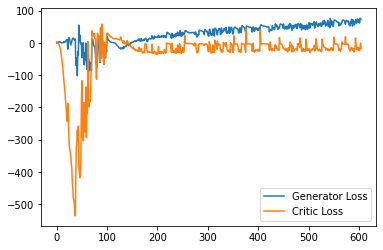

Step 12150: Generator loss: 61.77821716308594, critic loss: -22.04380020999908


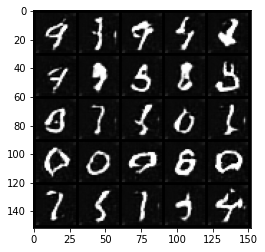

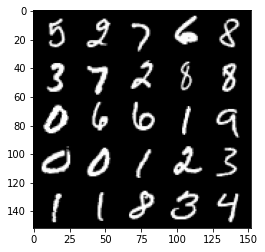

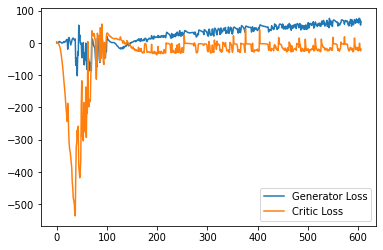

Step 12200: Generator loss: 68.92045553207397, critic loss: -8.935266328811643


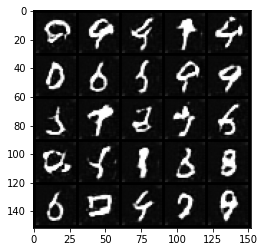

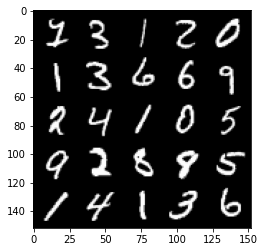

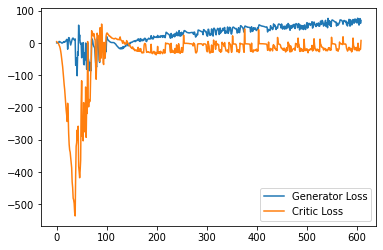

Step 12250: Generator loss: 71.01429779052734, critic loss: -15.848153209686277


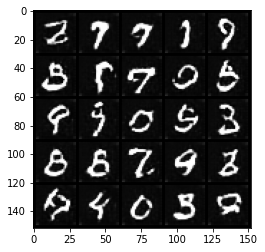

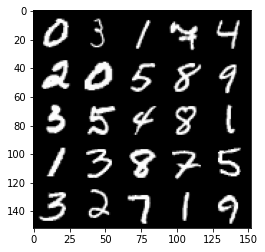

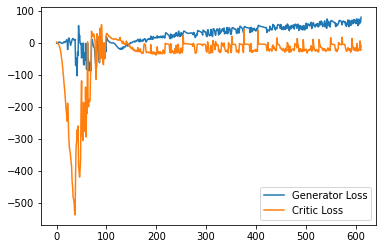

Step 12300: Generator loss: 73.52155776977538, critic loss: -18.933214589595796


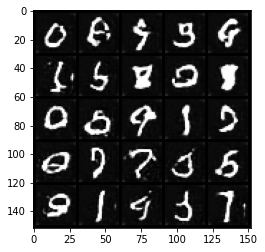

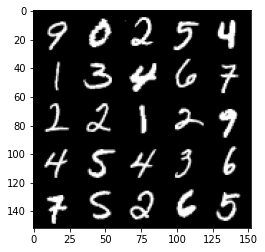

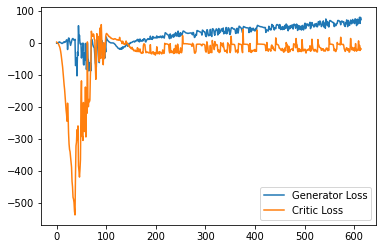

Step 12350: Generator loss: 66.30841323852539, critic loss: -22.291166083335874


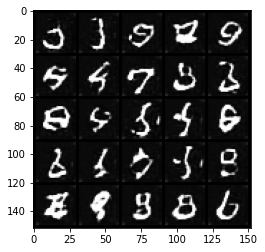

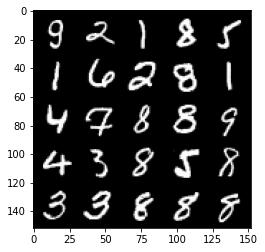

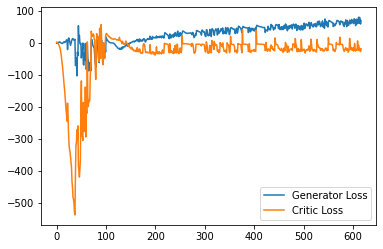

Step 12400: Generator loss: 71.5870314025879, critic loss: -7.424994922637943


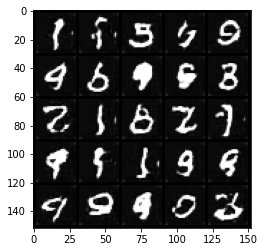

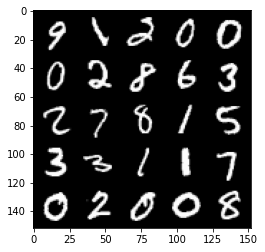

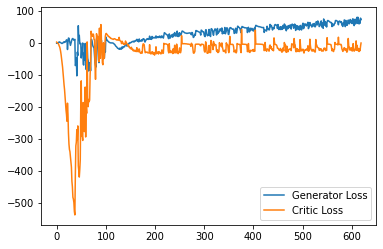

Step 12450: Generator loss: 66.95277076721192, critic loss: -19.054905704021454


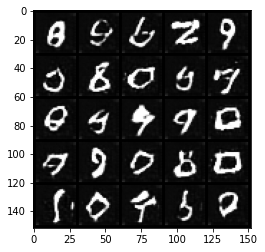

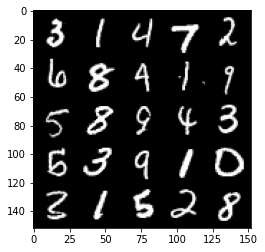

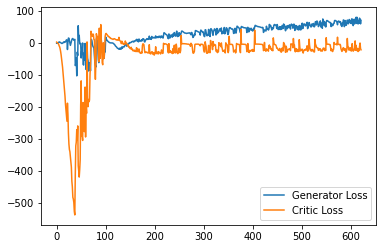

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
